# Проект по исследованию рынка заведений общественного питания Москвы.

**Цель** - исследовать рынок заведений общественног питания Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут инвесторам из фонда «Shut Up and Take My Money» в выборе подходящего места и типа заведения.
Данные - датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

**Описание данных**, файл moscow_places.csv:
- `name` — название заведения
- `address` — адрес заведения
- `category` — категория заведения, например «кафе», «пиццерия» или «кофейня»
- `hours` — информация о днях и часах работы
- `lat` — широта географической точки, в которой находится заведение;
- `lng` — долгота географической точки, в которой находится заведение;
- `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- `price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
«Средний счёт: 1000–1500 ₽»;
«Цена чашки капучино: 130–220 ₽»;
«Цена бокала пива: 400–600 ₽».
и так далее;
- `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
- `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
- `chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки);
- `district` — административный район, в котором находится заведение, например Центральный административный округ;
- `seats` — количество посадочных мест.

# План исследования
1. [Загрузка и предобработка данных](#start)
    - [Загрузка и изучение данных](#upload)
    - [Обработка пропусков и не явных дубликатов](#preparing)
    - [Создание дополнительных столбцов](#new_columns)
    - [Вывод по этапу предобработки данных](#start_conclusion)
2. [Исследовательский анализ данных](#analysis)
    - [Категории заведений, представленных в данных](#analysis_1)
    - [Количество посадочных мест по категориям](#analysis_2)
    - [Соотношение сетевых и несетевых заведений](#analysis_3)
    - [Распределение сетевых заведений по категориям](#analysis_4)
    - [Самые популярные сетевые заведения в Москве](#analysis_5)
    - [Распределение заведений по районам Москвы](#analysis_6)
    - [Средние рейтинги по категориям заведений](#analysis_7)
    - [Фоновая картограмма со средним рейтингом заведений каждого района](#analysis_8)
    - [Карта Москвы с заведениями общественного питания](#analysis_9)
    - [Улицы с наибольшим количеством заведений общественного питания](#analysis_10)
    - [Улицы с только одним заведением общепита](#analysis_11)
    - [Ценовые индикаторы районов города](#analysis_12)
    - [Исследование заведений с плохим рейтингом](#analysis_13)
    - [Выводы по исследовательскому анализу данных](#analysis_conclusion)
3. [Исследование по открытию кофейни](#cofe)
    - [Сколько кофеен в датасете и как они распределены](#cofe_1)
    - [Режим работы кофеен, есть ли круглосуточные](#cofe_2)
    - [Рейтинги кофеен и их распределение по районам](#cofe_3)
    - [Ориентировочная стоимость чашки капучино при открытии](#cofe_4)
    - [Рекомендации по открытию нового заведения](#recomendations)
4. [Общий вывод](#final)


<a id='start'></a>
## Загрузка и предобработка данных

<a id='upload'></a>
### Загрузка и изучение данных

In [1]:
# Подключение библиотек
import pandas as pd # Pandas
import matplotlib.pyplot as plt # Визуализация
import seaborn as sns # Визуализация №2
import datetime as dt # Преобразование данных к типу дата
import math as mth # Математические вычисления
import numpy as np # Высокоуровневые вычисления
from scipy import stats as st # Для статистических расчетов
import matplotlib.gridspec as gridspec # Инструмент для задания положения полей с графиками
import json # Модуль для работы с JSON форматом 
from folium import Map, Choropleth, Marker # Модули для работы с картой
from folium.plugins import MarkerCluster # Модуль для кластеров
from folium.features import CustomIcon # Импортирт собственных иконок

# Единый стиль для графиков
sns.set_palette('pastel') # цветовая палитра "пастель"
sns.set_style('dark') # темный стиль без сетки

# Переменные для вывода текста
clr_g = '\033[32m' # зеленый текст
clr_b = '\033[0m' # обычный текст

path = r'c:/projects/datasets/moscow_places.csv' # путь к файлу с данными

# путь к файлу с географическими данные об округах Москвы в формате JSON
path_geo = r'c:/projects/datasets/admin_level_geomap.geojson' 

In [2]:
# Загрузка файла
try:
    df = pd.read_csv(path)
except:
    print('Попробуйте другие параметры.')

In [3]:
# Получение общей информации от таблице с данными
print(clr_g, '\nТаблица:', clr_b)
display(df.head(5))
print(clr_g, '\nОписание таблицы:', clr_b)
display(df.describe())
print(clr_g, '\nСтруктура таблицы:', clr_b)
df.info()
print()
print('Количество явных дубликатов:', clr_g, df.duplicated().sum(), clr_b)
print('Доля дубликатов в данных:', clr_g, '{:.1%}'.format(df.duplicated().sum() / len(df)), clr_b)
print(clr_g, '\nКоличество пропусков в таблице:', clr_b)
df.isna().sum()

 
Таблица: 


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


 
Описание таблицы: 


,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406.000000,8406.000000,8406.000000,3149.000000,535.000000,8406.000000,4795.000000
mean,55.750109,37.608570,4.229895,958.053668,174.721495,0.381275,108.421689
std,0.069658,0.098597,0.470348,1009.732845,88.951103,0.485729,122.833396
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705155,37.538583,4.100000,375.000000,124.500000,0.000000,40.000000
50%,55.753425,37.605246,4.300000,750.000000,169.000000,0.000000,75.000000
75%,55.795041,37.664792,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


 
Структура таблицы: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB

Количество явных дубликатов:  0 
Доля 

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

В таблице представлена информация о 8 406 заведениях общественного питания г. Москвы. 

Типы данных столбцов не требуют корректировки, кроме столбца `seats` (колиечество посадочных мест), его можно преобразовать из `float` в `int` для экономии комьютерной памяти. 

Явные дубликаты в данных отсутствуют. Нужно проверить неявные дубликаты в столбцах `name`, `address`.

В ряде столбцов есть пропуски. Предварительная стратегия для обработки пропусков: 
- пропуски в столбце `hours`, рабочие часы заполнить значением `нет данных`, не удалять, чтобы не потерять ценную информацию.  
- пропусков в столбцах `middle_avg_bill`, `seats` очень много, если заполнять средними или медианными значениями, в датасет добавится практически половина синтетических данных, это приведет к большим искажениям. Заполним пропуски нулями, при дальнейших расчетах нулевые значения будем отбрасывать.  
- Пропуски в столбце `avg_bill` заполним значениями из `middle_avg_bill`, нулевые значения будем отбрасывать при анализе.
- пропусков в столбце `middle_coffee_cup` очень много, есть всего 535 значений из 8 406. Заполняем пропуски нулями. Для дальнейшго анализа запоминаем, что при расчетах по этому столбцу нужно отбрасывать нулевые значения. 
- пропуски в столбце `price` заполним соответствующими категориям исходя из значений `middle_avg_bill`. 

В столбце `seats`, возможно, присутствуют аномальные значения, связанные с ошибками при вводе данных, максимальное значение 1288 посадочных мест, минимальное - 0.

<a id='preparing'></a>
### Обработка пропусков и не явных дубликатов

In [4]:
df_filled = df.copy() # Датафрейм для преобразования

In [5]:
# Поиск неявных дубликатов в столбце name
print('Всего уникальных названий заведений:', clr_g, df_filled['name'].nunique(), clr_b)
df_filled['name'] = df_filled['name'].str.lower() # Приводим к строчным буквам
print('Всего уникальных названий заведений после приведения символов к нижнему регистру:', 
      clr_g, df_filled['name'].nunique(), clr_b)
print(clr_g, '\nТОП20 самых распространенных по количеству адресов названий:', clr_b)
display(df_filled.groupby('name', as_index=False)['address'].count().sort_values(by='address', ascending=False).head(20))

Всего уникальных названий заведений:  5614 
Всего уникальных названий заведений после приведения символов к нижнему регистру:  5512 
 
ТОП20 самых распространенных по количеству адресов названий: 


,name,address
2825,кафе,189
5418,шоколадница,120
2532,домино'с пицца,77
2500,додо пицца,74
1137,one price coffee,72
5491,яндекс лавка,69
413,cofix,65
1263,prime,50
4993,хинкальная,44
5319,шаурма,43


Попробуем найти неявные дубликаты в распространенных названиях:
- `кафе` - может быть `cafe`, но это могут быть и разные названия. Сложно сделать вывод, не будем рассматривать.
- `домино'с пицца` - может быть `dominos`
- `додо пицца` - может быть `dodo`
- `one price coffee` - может быть `уан (ван) прайс кофе`
- `яндекс лавка` - прверить, есть ли `yandex`
- `cofix` - `кофикс`
- `prime` - `прайм`
- `кофепорт` - `cofeport`
- `кулинарная лавка братьев караваевых` - могут быть опечатки, ищем `караваевых`, проверяем совпадет ли количество
- `cofefest` - `кофефест`
- `drive café` - `драйв кафе`

In [6]:
# Шаблоны для поиска не явных дубликатов в столбце name
r = ['dominos', 'dodo', 'прайс кофе', 'yandex', 'кофикс', 'прайм', 'cofeport', 'караваевых', 'кофефест', 'драйв кафе']

# ищем строки, включающие слова из шаблонов
for i in range(len(r)):
    print(
    'Найдено строк, содержащих', clr_g, r[i], clr_b, ':',
    df_filled.loc[df_filled['name'].str.contains(r[i]) == True]['address'].count()
    )

Найдено строк, содержащих  dominos  : 0
Найдено строк, содержащих  dodo  : 0
Найдено строк, содержащих  прайс кофе  : 0
Найдено строк, содержащих  yandex  : 0
Найдено строк, содержащих  кофикс  : 0
Найдено строк, содержащих  прайм  : 4
Найдено строк, содержащих  cofeport  : 0
Найдено строк, содержащих  караваевых  : 39
Найдено строк, содержащих  кофефест  : 1
Найдено строк, содержащих  драйв кафе  : 0


In [7]:
# Вывод строки с кофефест
df_filled.loc[df_filled['name'].str.contains('кофефест')]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
5265,кофефест,кофейня,"Москва, Яузская улица, 11/6к5",Центральный административный округ,"пн-пт 08:00–19:00; сб,вс 09:00–17:00",55.745848,37.652562,3.9,NaN,NaN,NaN,NaN,0,NaN


In [8]:
df_filled.loc[5265, 'name'] = 'cofefest' # меняем название на английское

In [9]:
# Вывод строки с прайм
df_filled.loc[df_filled['name'].str.contains('прайм')]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1510,праймбиф бар,кафе,"Москва, Ленинградское шоссе, 16А, стр. 4",Северный административный округ,"ежедневно, 10:00–23:00",55.823216,37.496719,4.1,средние,Средний счёт:от 1000 ₽,1000.0,NaN,1,230.0
1886,прайм тайм,ресторан,"Москва, 1-я Останкинская улица, 7А, стр. 19",Северо-Восточный административный округ,"ежедневно, 12:00–23:00",55.824172,37.603565,4.3,выше среднего,Средний счёт:1500–3000 ₽,2250.0,NaN,0,230.0
6445,праймбиф бар,кафе,"Москва, улица Авиаконструктора Миля, 3А",Юго-Восточный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00",55.686941,37.851455,3.4,средние,Средний счёт:800–1200 ₽,1000.0,NaN,1,NaN
8234,кулинарная лавка прайм фуд,быстрое питание,"Москва, 2-й Павелецкий проезд, 5с1",Южный административный округ,пн-пт 09:00–19:00,55.712865,37.644444,3.9,NaN,NaN,NaN,NaN,0,NaN


Эти "праймы" не похожи на `prime`, оставляем без изменений.

In [10]:
print('Количество явных дубликатов:', clr_g, df.duplicated().sum(), clr_b)

Количество явных дубликатов:  0 


В столбце `name` избавились от нескольких не совпадений по названию, связанных с разницей в строчных / прописных буквах и от одного с написанием английского названия на русском.

Возможные неявные дубликаты в столбце `address`:
- разница строчных/прописных буквах
- разница, связанная с сокращением названием улица / ул., либо отсутствем этого слова
- отсутствие в адресе слова дом, либо разница дом/д.
- присутствие в адресе город/гор./г.

In [11]:
# Поиск неявных дубликатов в столбце address
print('Всего уникальных адресов:', clr_g, df_filled['address'].nunique(), clr_b)
df_filled['address'] = df_filled['address'].str.lower() # Приводим к строчным буквам
print('Всего уникальных названий заведений после приведения символов к нижнему регистру:', 
      clr_g, df_filled['address'].nunique(), clr_b)

Всего уникальных адресов:  5753 
Всего уникальных названий заведений после приведения символов к нижнему регистру:  5752 


Приведение адресов к прописному виду устранило одно не совпадение адреса.

In [12]:
# проверка есть ли в столбце address г. / гор. / город
r = ['г.', 'гор.', 'город'] # шаблоны для поиска

# ищем строки, включающие слова из шаблонов
for i in range(len(r)):
    print(
    'Найдено строк, содержащих', clr_g, r[i], clr_b, ':',
    df_filled.loc[df_filled['address'].str.contains(r[i], regex=False) == True]['address'].count()
    )

Найдено строк, содержащих  г.  : 0
Найдено строк, содержащих  гор.  : 0
Найдено строк, содержащих  город  : 34


Встречается написание "город", плюс есть записи где вообще нет указание на тип населенного пнкта Москва. Лучше удалить эти фрагменты из строк, таким образом останется просто вариант с написанием "Москва", без указания, что это город.

In [13]:
# удаляем город из строк
df_filled['address'] = df_filled['address'].str.replace('город', '')

print('Найдено строк, содержащих', clr_g, 'город', clr_b, ':',
    df_filled.loc[df_filled['address'].str.contains('город', regex=False) == True]['address'].count()
    )

Найдено строк, содержащих  город  : 0


Возможные варианты типа улицы:
- улица, ул.
- бульвар, бульв.
- аллея, алл.
- набережная, наб.
- проспект, просп., пр.-т
- проезд, пр., пр.-д
- переулок, пер.
- площадь, пл.
- шоссе, ш.

In [14]:
# проверка наличия вариантов в датасете
r = [
    'улица', 
    'ул.', 
    'бульвар', 
    'бульв.', 
    'аллея', 
    'алл.',
    'набережная',
    'наб.',
    'проспект',
    'просп.',
    'пр.-т',
    'проезд',
    'пр.',
    'пр.-д',
    'переулок',
    'пер.',
    'площадь',
    'пл.',
    'шоссе',
    'ш.'
    ] # шаблоны для поиска

# ищем строки, включающие слова из шаблонов
for i in range(len(r)):
    print(
    'Найдено строк, содержащих', clr_g, r[i], clr_b, ':',
    df_filled.loc[df_filled['address'].str.contains(r[i], regex=False) == True]['address'].count()
    )

Найдено строк, содержащих  улица  : 4936
Найдено строк, содержащих  ул.  : 2
Найдено строк, содержащих  бульвар  : 341
Найдено строк, содержащих  бульв.  : 0
Найдено строк, содержащих  аллея  : 15
Найдено строк, содержащих  алл.  : 0
Найдено строк, содержащих  набережная  : 178
Найдено строк, содержащих  наб.  : 0
Найдено строк, содержащих  проспект  : 981
Найдено строк, содержащих  просп.  : 0
Найдено строк, содержащих  пр.-т  : 0
Найдено строк, содержащих  проезд  : 443
Найдено строк, содержащих  пр.  : 0
Найдено строк, содержащих  пр.-д  : 0
Найдено строк, содержащих  переулок  : 439
Найдено строк, содержащих  пер.  : 0
Найдено строк, содержащих  площадь  : 185
Найдено строк, содержащих  пл.  : 0
Найдено строк, содержащих  шоссе  : 698
Найдено строк, содержащих  ш.  : 0


In [15]:
# выводим строки, содержащие ул.
df_filled.loc[df_filled['address'].str.contains('ул.', regex=False) == True]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2495,сеть поминальных залов,кафе,"москва, ул. ярославская, 8, корп. 1",Северо-Восточный административный округ,"ежедневно, 12:00–23:00",55.817542,37.647486,4.5,NaN,NaN,NaN,NaN,1,NaN
6847,jeffrey's coffee,кофейня,"москва, ул. профсоюзная, д.104",Юго-Западный административный округ,NaN,55.641920,37.523465,4.7,NaN,NaN,NaN,NaN,1,NaN


In [16]:
# замена ул. на улица
df_filled['address'] = df_filled['address'].str.replace('ул.', 'улица', regex=False)

print('Найдено строк, содержащих', clr_g, 'ул.', clr_b, ':',
    df_filled.loc[df_filled['address'].str.contains('ул.', regex=False) == True]['address'].count()
    )

Найдено строк, содержащих  ул.  : 0


In [17]:
# Индексы нахождения строки "улица" в строке с адресом
df_filled['address'].str.find('улица').unique()

array([ 8, 21, 22, 17, -1, 18, 19, 16, 20, 24, 23, 14, 30, 25, 27, 26, 29,
       12, 39, 41, 32, 15, 31, 79, 28, 59, 67, 75, 13, 80, 81],
      dtype=int64)

In [18]:
# индекс 8 - когда улица на первом месте, -1 - когда не найдено это слово
# переставляем слово улица на 1 место

for i in range(len(df_filled['address'])): # цикл по всему столбцу с адресами
    s = df_filled.loc[i, 'address'] # записываем значение текущей записи в переменную s

    if s.find('улица') > 8: # условие, что слово улица стоит не в правильном месте
        s = s.replace('улица', '') # удаляем слово улица из строки
        s_new = s[0: 8] + "улица " + s[8 :] # добавляем слово улица c пробелом в начало блока с улицей (после Москва,)
        # восьмой индекс после пробела, поэтому перед словом пробел не добавляем
        df_filled.loc[i, 'address'] = s_new # записываем переменную s_new в текущую ячейку

# проверка
df_filled['address'].str.find('улица').unique()

array([ 8, -1], dtype=int64)

In [19]:
# Индексы нахождения строки "аллея" в строке с адресом
df_filled['address'].str.find('аллея').unique()

array([ -1,  18, 118, 110,  30,  16,  17,   8,  94,  79], dtype=int64)

In [20]:
pd.options.display.max_colwidth = 150 # настройка максимальной ширины столбца
# Слова аллея нет на первом месте, рассмотрим эти 15 строк
df_filled.loc[df_filled['address'].str.contains('аллея') == True]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
801,додо пицца,пиццерия,"москва, берёзовая аллея, 5",Северо-Восточный административный округ,"ежедневно, 10:00–23:00",55.853708,37.609937,4.3,NaN,Средний счёт:344 ₽,344.0,NaN,1,24.0
949,хинкали gали,кафе,"москва, берёзовая аллея, 17, корп. 2",Северо-Восточный административный округ,"ежедневно, 12:00–23:00",55.849925,37.619594,4.4,NaN,NaN,NaN,NaN,0,NaN
1068,coffeekaldi's,кофейня,"москва, северо-восточный административный округ, останкинский район, выставка достижений народного хозяйства, главная аллея",Северо-Восточный административный округ,"пн-пт 10:00–22:00; сб,вс 09:00–23:00",55.827131,37.634827,4.6,NaN,NaN,NaN,NaN,1,NaN
1117,чайхана самарканд,ресторан,"москва, берёзовая аллея, 12к7",Северо-Восточный административный округ,"ежедневно, 08:00–23:00",55.848624,37.617686,4.0,NaN,NaN,NaN,NaN,1,NaN
1157,big city,кафе,"москва, берёзовая аллея, 5а, стр. 6",Северо-Восточный административный округ,"пн-пт 10:00–22:00; сб,вс 10:00–21:00",55.848422,37.619468,3.9,NaN,NaN,NaN,NaN,0,NaN
1159,едаки,быстрое питание,"москва, северо-восточный административный округ, останкинский район, территория парка останкино, останкинская аллея",Северо-Восточный административный округ,"ежедневно, 11:00–20:00",55.826663,37.617357,3.4,NaN,NaN,NaN,NaN,0,NaN
1174,скалка,булочная,"москва, берёзовая аллея, 17, корп. 2",Северо-Восточный административный округ,"ежедневно, 08:00–22:00",55.849691,37.620905,4.4,NaN,NaN,NaN,NaN,1,NaN
1813,итальянские каникулы,кафе,"москва, петровско-разумовская аллея, 10, корп. 3",Северный административный округ,"ежедневно, 11:00–23:00",55.793520,37.560531,4.2,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,0,24.0
1840,chicken mania,ресторан,"москва, беговая аллея, 3а",Северный административный округ,"ежедневно, 11:00–23:00",55.783473,37.564979,4.3,средние,Средний счёт:350–500 ₽,425.0,NaN,0,NaN
2109,сирень,"бар,паб","москва, песочная аллея, 1",Восточный административный округ,"ежедневно, 12:00–23:00",55.793336,37.674980,4.3,высокие,Средний счёт:2000–2500 ₽,2250.0,NaN,0,200.0


Оставляем строки с аллеей как есть, не преставляем на первое место слово.

In [21]:
# Индексы нахождения строки "бульвар" в строке с адресом
df_filled['address'].str.find('бульвар').unique()

array([-1,  8, 19, 22, 24, 17, 20, 18, 21, 16, 23], dtype=int64)

In [22]:
# проверка есть ли строки, содержащие одновременно бульвар и улица
df_filled.loc[(df_filled['address'].str.contains('бульвар') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'].count()

0

In [23]:
# индекс 8 - когда улица на первом месте, -1 - когда не найдено это слово
# переставляем слово бульвар на 1 место

for i in range(len(df_filled['address'])): # цикл по всему столбцу с адресами
    s = df_filled.loc[i, 'address'] # записываем значение текущей записи в переменную s

    if s.find('бульвар') > 8: # условие, что слово улица стоит не в правильном месте
        s = s.replace('бульвар', '') # удаляем слово улица из строки
        s_new = s[0: 8] + "бульвар " + s[8 :] # добавляем слово улица c пробелом в начало блока с улицей (после Москва,)
        # восьмой индекс после пробела, поэтому перед словом пробел не добавляем
        df_filled.loc[i, 'address'] = s_new # записываем переменную s_new в текущую ячейку

# проверка
df_filled['address'].str.find('бульвар').unique()

array([-1,  8], dtype=int64)

In [24]:
# Индексы нахождения строки "набережная" в строке с адресом
df_filled['address'].str.find('набережная').unique()

array([-1, 22, 26, 19, 17, 20, 21,  8, 24, 18, 23, 25], dtype=int64)

In [25]:
# проверка есть ли строки, содержащие одновременно набережная и улица
df_filled.loc[(df_filled['address'].str.contains('набережная') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'].count()

0

In [26]:
# индекс 8 - когда улица на первом месте, -1 - когда не найдено это слово
# переставляем слово набережная на 1 место

for i in range(len(df_filled['address'])): # цикл по всему столбцу с адресами
    s = df_filled.loc[i, 'address'] # записываем значение текущей записи в переменную s

    if s.find('набережная') > 8: # условие, что слово улица стоит не в правильном месте
        s = s.replace('набережная', '') # удаляем слово улица из строки
        s_new = s[0: 8] + "набережная " + s[8 :] # добавляем слово улица c пробелом в начало блока с улицей (после Москва,)
        # восьмой индекс после пробела, поэтому перед словом пробел не добавляем
        df_filled.loc[i, 'address'] = s_new # записываем переменную s_new в текущую ячейку

# проверка
df_filled['address'].str.find('набережная').unique()

array([-1,  8], dtype=int64)

In [27]:
# Индексы нахождения строки "проспект" в строке с адресом
df_filled['address'].str.find('проспект').unique()

array([-1,  8, 22, 20, 21, 17, 18, 16, 19, 47, 26, 24, 23], dtype=int64)

In [28]:
# проверка есть ли строки, содержащие одновременно проспект и улица
df_filled.loc[(df_filled['address'].str.contains('проспект') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'].count()

16

In [29]:
# Строки, содержащие одновременно улица и проспект
df_filled.loc[(df_filled['address'].str.contains('проспект') == True) & (
    df_filled['address'].str.contains('улица') == True)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
5632,андерсон,кафе,"москва, улица мичуринский проспект, олимпийская деревня, 3к1",Западный административный округ,"пн-пт 10:00–22:00; сб,вс 10:00–23:00",55.677984,37.467462,4.7,NaN,Средний счёт:1500 ₽,1500.0,NaN,1,NaN
5728,шоколадница,кофейня,"москва, улица мичуринский проспект, олимпийская деревня, 3к1",Западный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00–22:00",55.678463,37.467741,4.3,низкие,Цена чашки капучино:239–274 ₽,NaN,256.0,1,NaN
5754,pho dat viet,ресторан,"москва, улица мичуринский проспект, олимпийская деревня, 3, корп. 1",Западный административный округ,"ежедневно, 10:00–22:00",55.677731,37.466726,4.4,NaN,NaN,NaN,NaN,0,120.0
5772,арка,кафе,"москва, улица мичуринский проспект, олимпийская деревня, 1",Западный административный округ,"ежедневно, 10:00–23:00",55.677292,37.467801,3.9,NaN,NaN,NaN,NaN,0,120.0
5797,flat white,кофейня,"москва, улица мичуринский проспект, олимпийская деревня, 3к1",Западный административный округ,"ежедневно, 10:00–22:00",55.678028,37.466933,4.1,средние,Цена чашки капучино:100–200 ₽,NaN,150.0,0,NaN
5807,one price coffee,кофейня,"москва, улица мичуринский проспект, олимпийская деревня, 3, корп. 1",Западный административный округ,"ежедневно, 10:00–22:00",55.677946,37.466968,3.9,NaN,NaN,NaN,NaN,1,120.0
5868,dimsum & co,быстрое питание,"москва, улица мичуринский проспект, олимпийская деревня, 3к1",Западный административный округ,"ежедневно, 10:00–22:00",55.677821,37.466909,2.5,NaN,NaN,NaN,NaN,1,NaN
6542,florentini,ресторан,"москва, улица мичуринский проспект, олимпийская деревня, 4, корп. 3",Западный административный округ,"пн-чт 11:00–23:30; пт,сб 11:00–00:00; вс 11:00–23:30",55.675559,37.471417,4.7,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,1,150.0
6562,сатрапезо,ресторан,"москва, улица мичуринский проспект, олимпийская деревня, 3",Западный административный округ,"ежедневно, 11:00–00:00",55.676584,37.468233,4.6,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,0,150.0
6569,хинкальная,кафе,"москва, улица мичуринский проспект, олимпийская деревня, 4, корп. 32",Западный административный округ,"ежедневно, 12:00–00:00",55.673352,37.477122,4.5,NaN,NaN,NaN,NaN,1,60.0


In [30]:
# удаляем слово улица из строк, одновременно содержащих улица и проспект
df_filled.loc[(df_filled['address'].str.contains('проспект') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'] = df_filled.loc[(
    df_filled['address'].str.contains('проспект') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'].str.replace('улица', '')
# проверка
df_filled.loc[(df_filled['address'].str.contains('проспект') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'].count()

0

In [31]:
# индекс 8 - когда улица на первом месте, -1 - когда не найдено это слово
# переставляем слово проспект на 1 место

for i in range(len(df_filled['address'])): # цикл по всему столбцу с адресами
    s = df_filled.loc[i, 'address'] # записываем значение текущей записи в переменную s

    if s.find('проспект') > 8: # условие, что слово улица стоит не в правильном месте
        s = s.replace('проспект', '') # удаляем слово улица из строки
        s_new = s[0: 8] + "проспект " + s[8 :] # добавляем слово улица c пробелом в начало блока с улицей (после Москва,)
        # восьмой индекс после пробела, поэтому перед словом пробел не добавляем
        df_filled.loc[i, 'address'] = s_new # записываем переменную s_new в текущую ячейку

# проверка
df_filled['address'].str.find('проспект').unique()

array([-1,  8], dtype=int64)

In [32]:
# Индексы нахождения строки "проезд" в строке с адресом
df_filled['address'].str.find('проезд').unique()

array([-1, 17, 19, 21, 22, 18,  8, 25, 20, 24, 29, 16, 26, 23, 30, 37, 13,
       27, 12, 72, 33, 28, 14], dtype=int64)

In [33]:
# проверка есть ли строки, содержащие одновременно проезд и улица
df_filled.loc[(df_filled['address'].str.contains('проезд') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'].count()

0

In [34]:
# индекс 8 - когда улица на первом месте, -1 - когда не найдено это слово
# переставляем слово проезд на 1 место

for i in range(len(df_filled['address'])): # цикл по всему столбцу с адресами
    s = df_filled.loc[i, 'address'] # записываем значение текущей записи в переменную s

    if s.find('проезд') > 8: # условие, что слово улица стоит не в правильном месте
        s = s.replace('проезд', '') # удаляем слово улица из строки
        s_new = s[0: 8] + "проезд " + s[8 :] # добавляем слово улица c пробелом в начало блока с улицей (после Москва,)
        # восьмой индекс после пробела, поэтому перед словом пробел не добавляем
        df_filled.loc[i, 'address'] = s_new # записываем переменную s_new в текущую ячейку

# проверка
df_filled['address'].str.find('проезд').unique()

array([-1,  8], dtype=int64)

In [35]:
# Индексы нахождения строки "переулок" в строке с адресом
df_filled['address'].str.find('переулок').unique()

array([-1, 24, 25, 23, 29, 19, 20, 27, 17, 22, 21, 18, 16, 15, 26, 31, 28,
        8, 12, 30, 33, 14, 34, 13], dtype=int64)

In [36]:
# проверка есть ли строки, содержащие одновременно переулок и улица
df_filled.loc[(df_filled['address'].str.contains('переулок') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'].count()

0

In [37]:
# индекс 8 - когда улица на первом месте, -1 - когда не найдено это слово
# переставляем слово переулок на 1 место

for i in range(len(df_filled['address'])): # цикл по всему столбцу с адресами
    s = df_filled.loc[i, 'address'] # записываем значение текущей записи в переменную s

    if s.find('переулок') > 8: # условие, что слово улица стоит не в правильном месте
        s = s.replace('переулок', '') # удаляем слово улица из строки
        s_new = s[0: 8] + "переулок " + s[8 :] # добавляем слово улица c пробелом в начало блока с улицей (после Москва,)
        # восьмой индекс после пробела, поэтому перед словом пробел не добавляем
        df_filled.loc[i, 'address'] = s_new # записываем переменную s_new в текущую ячейку

# проверка
df_filled['address'].str.find('переулок').unique()

array([-1,  8], dtype=int64)

In [38]:
# Индексы нахождения строки "площадь" в строке с адресом
df_filled['address'].str.find('площадь').unique()

array([-1,  8, 17, 20, 23, 22, 21, 27, 19, 18, 26, 14, 28, 16],
      dtype=int64)

In [39]:
# проверка есть ли строки, содержащие одновременно площадь и улица
df_filled.loc[(df_filled['address'].str.contains('площадь') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'].count()

0

In [40]:
# индекс 8 - когда улица на первом месте, -1 - когда не найдено это слово
# переставляем слово площадь на 1 место

for i in range(len(df_filled['address'])): # цикл по всему столбцу с адресами
    s = df_filled.loc[i, 'address'] # записываем значение текущей записи в переменную s

    if s.find('площадь') > 8: # условие, что слово улица стоит не в правильном месте
        s = s.replace('площадь', '') # удаляем слово улица из строки
        s_new = s[0: 8] + "площадь " + s[8 :] # добавляем слово улица c пробелом в начало блока с улицей (после Москва,)
        # восьмой индекс после пробела, поэтому перед словом пробел не добавляем
        df_filled.loc[i, 'address'] = s_new # записываем переменную s_new в текущую ячейку

# проверка
df_filled['address'].str.find('площадь').unique()

array([-1,  8], dtype=int64)

In [41]:
# Индексы нахождения строки "шоссе" в строке с адресом
df_filled['address'].str.find('шоссе').unique()

array([-1, 20, 22, 21, 23, 19, 17, 18,  8, 14, 15], dtype=int64)

In [42]:
# проверка есть ли строки, содержащие одновременно шоссе и улица
df_filled.loc[(df_filled['address'].str.contains('шоссе') == True) & (
    df_filled['address'].str.contains('улица') == True), 'address'].count()

12

In [43]:
# Строки, содержащие одновременно улица и шосссе
df_filled.loc[(df_filled['address'].str.contains('шоссе') == True) & (
    df_filled['address'].str.contains('улица') == True)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6418,домино'с пицца,пиццерия,"москва, улица шоссейная , 33",Юго-Восточный административный округ,"ежедневно, 10:00–22:00",55.679675,37.724510,4.2,NaN,Средний счёт:от 500 ₽,500.0,NaN,1,15.0
6460,кафе эталон,кафе,"москва, улица шоссейная , 1ас50",Юго-Восточный административный округ,пн-ср 10:00–01:00; чт-сб 10:00–03:00; вс 10:00–01:00,55.695514,37.728227,2.5,NaN,NaN,NaN,NaN,0,NaN
6475,ммм вкусно,ресторан,"москва, улица шоссейная , 52, корп. 2",Юго-Восточный административный округ,пн-чт 10:00–22:00; пт 12:00–00:00; сб 10:00–22:00,55.678857,37.720201,4.2,NaN,NaN,NaN,NaN,0,84.0
6490,суши роллы,кафе,"москва, улица шоссейная , 34, стр. 1",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.682711,37.722738,4.3,NaN,NaN,NaN,NaN,0,40.0
6509,кавказский дворик,ресторан,"москва, улица шоссейная , 52, корп. 2",Юго-Восточный административный округ,"ежедневно, 11:00–00:00",55.678821,37.720232,4.4,средние,Средний счёт:400–800 ₽,600.0,NaN,0,84.0
7395,чудо печка,кафе,"москва, улица шоссейная , 66, корп. 2",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.673610,37.722477,4.2,высокие,Средний счёт:500–5000 ₽,2750.0,NaN,0,84.0
7433,кафе,кафе,"москва, улица шоссейная , 100, стр. 11",Юго-Восточный административный округ,NaN,55.661751,37.714459,4.0,NaN,NaN,NaN,NaN,0,NaN
7553,кофе с собой,кафе,"москва, улица шоссейная , 90, стр. 5",Юго-Восточный административный округ,пн-пт 08:30–17:30,55.664083,37.708985,4.6,NaN,NaN,NaN,NaN,1,NaN
8306,хинкальная № 5,"бар,паб","москва, улица шоссейная , 34, стр. 1",Юго-Восточный административный округ,"ежедневно, 11:00–00:00",55.682558,37.722975,4.4,средние,Средний счёт:500–700 ₽,600.0,NaN,0,40.0
8318,дадали,булочная,"москва, улица шоссейная , 30, стр. 2",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.683652,37.723305,4.7,NaN,NaN,NaN,NaN,0,84.0


In [44]:
# перечень адресов, содержащих шоссейная улица:
list_highway = list(df_filled.loc[(df_filled['address'].str.contains('шоссе') == True) & (
    df_filled['address'].str.contains('улица') == True)]['address'])

In [45]:
# индекс 8 - когда улица на первом месте, -1 - когда не найдено это слово
# переставляем слово шоссе на 1 место, кроме строк с шоссейной улицей

for i in range(len(df_filled['address'])): # цикл по всему столбцу с адресами
    s = df_filled.loc[i, 'address'] # записываем значение текущей записи в переменную s

    if (s.find('шоссе') > 8) and (s not in list_highway): # условие, что слово стоит не в правильном месте
        s = s.replace('шоссе', '') # удаляем слово улица из строки
        s_new = s[0: 8] + "шоссе " + s[8 :] # добавляем слово улица c пробелом в начало блока с улицей (после Москва,)
        # восьмой индекс после пробела, поэтому перед словом пробел не добавляем
        df_filled.loc[i, 'address'] = s_new # записываем переменную s_new в текущую ячейку

# проверка
df_filled['address'].str.find('шоссе').unique()

array([-1,  8, 14], dtype=int64)

In [46]:
# Проверка на дубликаты
df_filled.duplicated().sum()

0

Выявлено несколько не явных дубликатов в столбцах с названиями заведений и их адресов.

In [47]:
# преобразование типа столбца seats
# Заполним пропуски нулями (имеющиеся изначально значения 0 посадочных мест - тоже аномалии)
df_filled['seats'] = df_filled['seats'].fillna(0)
# Преобразуем в целочисленный тип
df_filled['seats'] = df_filled['seats'].astype(int)
df_filled['seats'].isna().sum() #контроль

0

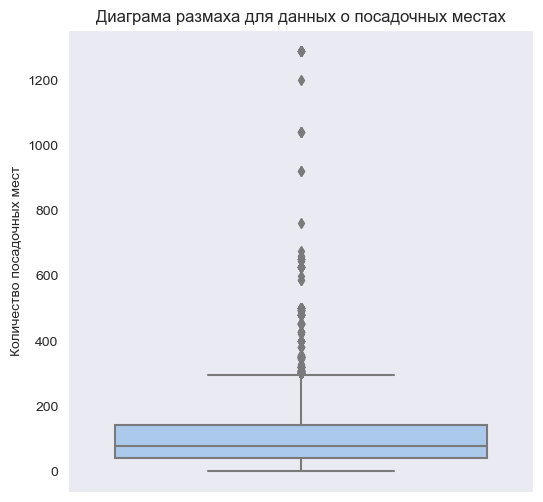

99% заведений имеют менее  625  посадочных мест


In [48]:
# Диаграмма размаха для столбца Seats
df_filtered = df_filled.query('seats != 0')
plt.figure(figsize=(6, 6))
plt.title('Диаграма размаха для данных о посадочных местах')
ax = sns.boxplot(y='seats', data=df_filtered)
plt.ylabel('Количество посадочных мест')
plt.show();
abnormal_seats = round(np.percentile(df_filtered['seats'], 99))
print('99% заведений имеют менее', clr_g, abnormal_seats, clr_b, 'посадочных мест')

In [49]:
# Заведения с более чем 625 посадочными местами.
print(
    '\nКоличество заведений с аномально большим количеством посадочных мест:',
    clr_g,
    df_filled.loc[(df_filled['seats'] > abnormal_seats), 'seats'].count(),
    clr_b
    )
print(clr_g, '\nВерхняя часть списка заведений с аномально большим количеством посадочных мест:', clr_b)
display(df_filled.sort_values(by='seats', ascending=False).head(5))
print(clr_g, '\nНижняя часть списка заведений с аномально большим количеством посадочных мест:', clr_b)
display(df_filled.loc[(df_filled['seats']> abnormal_seats)].sort_values(
    by='seats', ascending=False).tail(5))


Количество заведений с аномально большим количеством посадочных мест:  30 
 
Верхняя часть списка заведений с аномально большим количеством посадочных мест: 


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6524,ян примус,ресторан,"москва, проспект вернадского, 121, корп. 1",Западный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00–00:00",55.657166,37.481519,4.5,выше среднего,Средний счёт:1500 ₽,1500.0,NaN,1,1288
6838,alternative coffee,кофейня,"москва, проспект вернадского, 41, стр. 1",Западный административный округ,"пн-пт 09:00–21:00; сб,вс 09:00–22:00",55.673128,37.502992,4.3,NaN,NaN,NaN,NaN,0,1288
6690,японская кухня,ресторан,"москва, проспект вернадского, 121, корп. 1",Западный административный округ,NaN,55.657255,37.481547,4.4,NaN,NaN,NaN,NaN,1,1288
6807,loft-cafe академия,кафе,"москва, проспект вернадского, 84, стр. 1",Западный административный округ,пн-пт 09:00–20:00; сб 09:00–16:00,55.665142,37.478603,3.6,NaN,NaN,NaN,NaN,0,1288
6808,яндекс лавка,ресторан,"москва, проспект вернадского, 51, стр. 1",Западный административный округ,"ежедневно, круглосуточно",55.672580,37.507753,4.0,NaN,NaN,NaN,NaN,1,1288


 
Нижняя часть списка заведений с аномально большим количеством посадочных мест: 


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
5720,ресторан китайской кухни чуаньюй,ресторан,"москва, проспект мичуринский , 7, корп. 1",Западный административный округ,"ежедневно, 11:00–23:00",55.700431,37.512799,4.4,средние,NaN,NaN,NaN,0,650
5655,the fox pub,"бар,паб","москва, проспект мичуринский , 22, корп. 1",Западный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00–00:00",55.701625,37.504137,4.7,NaN,NaN,NaN,NaN,0,650
5841,for your kids,кафе,"москва, проспект мичуринский , 58, корп. 1",Западный административный округ,NaN,55.691382,37.486793,3.3,NaN,NaN,NaN,NaN,0,650
6548,vibes cafe,кафе,"москва, улица миклухо-маклая, 6",Юго-Западный административный округ,пн-пт 09:00–20:00; сб 09:00–16:00,55.651882,37.499295,4.4,NaN,NaN,NaN,NaN,0,644
6696,кабул,ресторан,"москва, улица миклухо-маклая, 6",Юго-Западный административный округ,пн-пт 07:00–21:00; сб 07:00–18:00,55.652025,37.498719,4.3,NaN,NaN,NaN,NaN,1,644


В верхней части списка заведения, такие как кафе или кофейни с 1288 посадочными местами. Сложно представить даже ресторан на такое количество посадочных мест. Такое количество гостей может принять, наверное, временно переоборудованное под мероприятие большое сооружение, как "Гостиный двор" или стадион. В нижней части списка заведения с также не реальным количеством посадочных мест. Например, ресторан <c>[Ресторан китайской кухни Чуаньюй](https://tomesto.ru/moskva/places/chuanyuy/banket)</c> на Ленинском проспекте по открытым источникам имеет только 244 мес.

Заполняем аномальные значения медианными значенями по категории заведения.

In [50]:
# Заполняем аномальные значения в столбце seats медианными значенями по категории заведения.
for i in list(df_filled['category'].unique()):
    df_filled.loc[(df_filled['seats'] > abnormal_seats) &\
                  (df_filled['category'] == i), 'seats'] = df_filled.loc[(df_filled['category'] == i), 'seats'].median()
df_filled['seats'].isna().sum()

0

C:\Users\IgorYu\AppData\Local\Temp\ipykernel_10896\2292739641.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['seats'], bins=10).set(
C:\Users\IgorYu\AppData\Local\Temp\ipykernel_10896\2292739641.py:11: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_filled['seats'], bins=10).set(
C:\Use

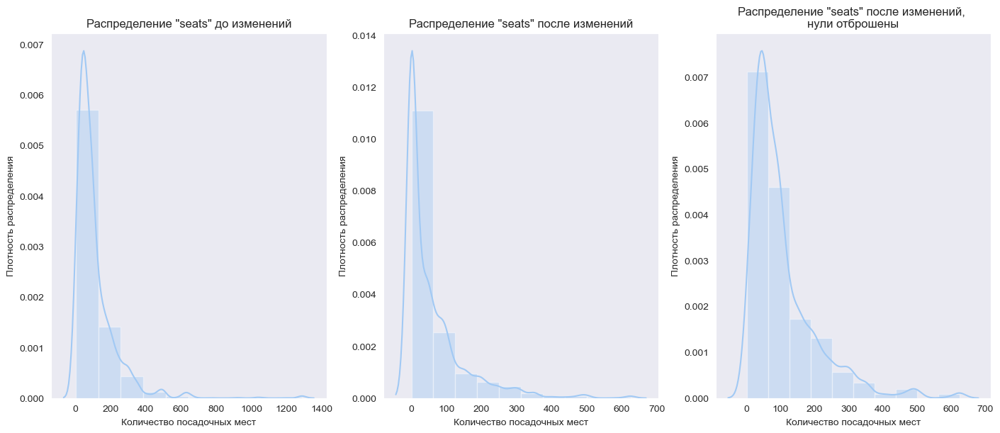

In [51]:
# Распределение величины seats до и после изменений
fg = plt.figure(figsize=(14, 6), constrained_layout=True)
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fg)
fig_ax_1 = fg.add_subplot(gs[0, 0])
sns.distplot(df['seats'], bins=10).set(
    title='Распределение "seats" до изменений',
    xlabel = 'Количество посадочных мест',
    ylabel = 'Плотность распределения'
    )
fig_ax_2 = fg.add_subplot(gs[0, 1])
sns.distplot(df_filled['seats'], bins=10).set(
    title='Распределение "seats" после изменений',
    xlabel = 'Количество посадочных мест',
    ylabel = 'Плотность распределения'
    )
fig_ax_3 = fg.add_subplot(gs[0, 2])
sns.distplot(df_filled.query('seats != 0')['seats'], bins=10).set(
    title='Распределение "seats" после изменений, \nнули отброшены',
    xlabel = 'Количество посадочных мест',
    ylabel = 'Плотность распределения'
    );

In [52]:
# Заполнение нулями пропусков с столбце 'middle_avg_bill'
df_filled['middle_avg_bill'] = df['middle_avg_bill'].copy()
df_filled['middle_avg_bill'] = df_filled['middle_avg_bill'].fillna(0)
df_filled['middle_avg_bill'].isna().sum()

0

C:\Users\IgorYu\AppData\Local\Temp\ipykernel_10896\2732999967.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['middle_avg_bill'], bins=20).set(
C:\Users\IgorYu\AppData\Local\Temp\ipykernel_10896\2732999967.py:11: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_filled['middle_avg_bill'], 

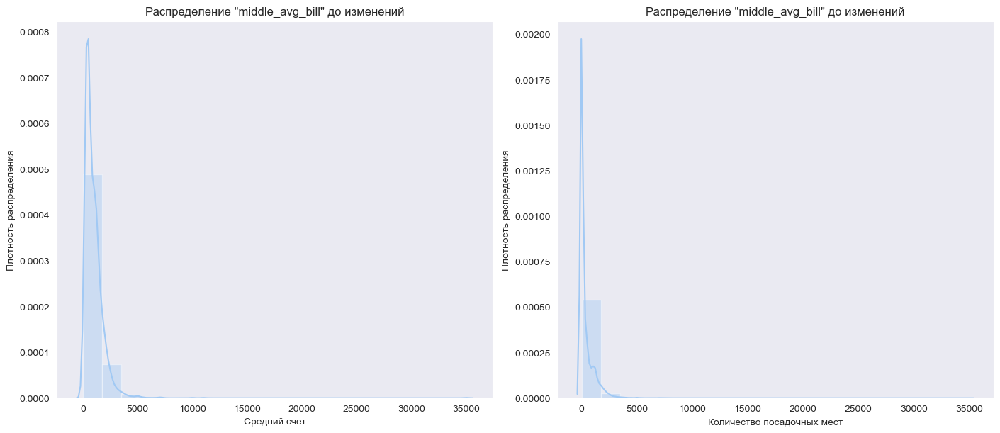

In [53]:
# Распределение величины middle_avg_bill до и после изменений
fg = plt.figure(figsize=(14, 6), constrained_layout=True)
gs = gridspec.GridSpec(ncols=2, nrows=1, figure=fg)
fig_ax_1 = fg.add_subplot(gs[0, 0])
sns.distplot(df['middle_avg_bill'], bins=20).set(
    title='Распределение "middle_avg_bill" до изменений',
    xlabel = 'Средний счет',
    ylabel = 'Плотность распределения'
    )
fig_ax_2 = fg.add_subplot(gs[0, 1])
sns.distplot(df_filled['middle_avg_bill'], bins=20).set(
    title='Распределение "middle_avg_bill" до изменений',
    xlabel = 'Количество посадочных мест',
    ylabel = 'Плотность распределения'
    );

In [54]:
# Заполнение пропусков в столбце hours
df_filled['hours'] = df_filled['hours'].fillna('нет данных')
df_filled['hours'].isna().sum()

0

In [55]:
# Заполнение пропусков в столбце middle_coffee_cup
df_filled['middle_coffee_cup'] = df_filled['middle_coffee_cup'].fillna(0)
df_filled['middle_coffee_cup'].isna().sum()  

0

In [56]:
# Заполнение пропусков в столбце avg_bill значениями из middle_avg_bill
df_filled['avg_bill'] = df_filled['avg_bill'].fillna(df_filled['middle_avg_bill'].astype('str'))
df_filled['avg_bill'].isna().sum()

0

In [57]:
# Обработка пропусков в столбце price
price_list = df_filled.loc[(df_filled['price'].isna() == False), 'price'].unique() # Находим существующие категори
print(clr_g, 'Существующие категории в столбце "price":\n', clr_b, price_list)

 Существующие категории в столбце "price":
  ['выше среднего' 'средние' 'высокие' 'низкие']


Если в столбце middle_avg_bill указан 0, это означает, что данных у нас нет, в этом случае нужно внести категорию "нет данных".
Если в столбце middle_avg_bill есть значение, можно заполнить категорию исходя из этого значения.

In [58]:
# Заполняем пропуски в price для случая, если в middle_avg_bill указан 0
df_filled.loc[(df_filled['price'].isna()) & (df_filled['middle_avg_bill'] == 0), 'price'] = 'нет данных'

In [59]:
# Находим максимальные, минимальные и средние значения middle_avg_bill для категорий price
max_bill = []
min_bill = []
for i in price_list:
    max_bill.append(df_filled.loc[(df_filled['price'] == i) & (df_filled['middle_avg_bill'] != 0), 'middle_avg_bill'].max())
    min_bill.append(df_filled.loc[(df_filled['price'] == i) & (df_filled['middle_avg_bill'] != 0), 'middle_avg_bill'].min())
print(max_bill)
print(min_bill)

[4500.0, 2150.0, 35000.0, 600.0]
[375.0, 165.0, 950.0, 90.0]


In [60]:
# заполняем столбец price для сучая, когда в middle_avg_bill не 0
for i in range(0, len(price_list)):
    df_filled.loc[((df_filled['price'].isna()) & (df_filled['middle_avg_bill'] >= min_bill[i]) & (df_filled['middle_avg_bill'] <= max_bill[i])), 'price'] = price_list[i]
df_filled['price'].isna().sum()

6

In [61]:
# Оставшиеся 6 пропусков в столбце price
df_filled.loc[df_filled['price'].isna()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1951,пончики! выпекаем на месте,кофейня,"москва, улица яблочкова, 19г",Северо-Восточный административный округ,"ежедневно, 08:00–22:00",55.819120,37.578073,4.6,NaN,Средний счёт:от 50 ₽,50.0,0.0,1,250
2316,монастырская чайная,кафе,"москва, переулок 2-й красносельский , 5с3",Центральный административный округ,"ежедневно, 09:00–21:00",55.783773,37.666269,4.1,NaN,Средний счёт:35–100 ₽,67.0,0.0,0,0
5420,пончики! выпекаем на месте,булочная,"москва, улица новокосинская , 35",Восточный административный округ,"ежедневно, 08:00–22:00",55.743570,37.866127,4.3,NaN,Средний счёт:от 50 ₽,50.0,0.0,1,4
6543,пончики! выпекаем на месте,кофейня,"москва, проспект вернадского, 109",Западный административный округ,пн-сб 08:00–22:00; вс 09:00–22:00,55.662333,37.483580,4.7,NaN,Средний счёт:от 50 ₽,50.0,0.0,1,5
7297,пончики! выпекаем на месте,кофейня,"москва, улица люблинская , 163/1",Юго-Восточный административный округ,"ежедневно, 08:00–22:00",55.651354,37.744222,4.7,NaN,Средний счёт:50 ₽,50.0,0.0,1,93
7545,шаурмян у арена,быстрое питание,"москва, улица краснодарская , 47",Юго-Восточный административный округ,"ежедневно, 09:00–23:00",55.677744,37.764810,3.3,NaN,Средний счёт:от 30 ₽,30.0,0.0,0,2


In [62]:
# Оставшиеся 6 пропусков в столбце price заполним значением 'низкие'
df_filled['price'] = df_filled['price'].fillna('низкие')
df_filled['price'].isna().sum()

0

In [63]:
# Контроль
df_filled.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              8406 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              8406 non-null   object 
 9   avg_bill           8406 non-null   object 
 10  middle_avg_bill    8406 non-null   float64
 11  middle_coffee_cup  8406 non-null   float64
 12  chain              8406 non-null   int64  
 13  seats              8406 non-null   int32  
dtypes: float64(5), int32(1), int64(1), object(7)
memory usage: 886.7+ KB


<a id='new_columns'></a>
### Создание дополнительных столбцов

In [64]:
# Создание столбца с названием улицы
df_adress = df_filled['address'].str.split(',', expand=True)
df_filled['street'] = df_adress[1]
df_filled.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,нет данных,0.0,0.0,0.0,0,0,улица дыбенко
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,0.0,0,4,улица дыбенко
2,хазри,кафе,"москва, улица клязьминская , 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,0.0,0,45,улица клязьминская
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,нет данных,Цена чашки капучино:155–185 ₽,0.0,170.0,0,0,улица маршала федоренко
4,иль марко,пиццерия,"москва, улица правобережная , 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,0.0,1,148,улица правобережная


Для создания столбца `is_24/7` с обозначением, что заведение работает ежедневно и круглосуточно нужно понять какие шаблоны поиска можно применить к столбцу `hours` для отбора необходимых строк.

In [65]:
# Создание столбца is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно
print('\nУникальные значения столбца hours:', clr_g, df_filled['hours'].nunique(), clr_b)
print('\nУникальные значения столбца hours cо словом "круглосуточно":', clr_g, df_filled.loc[(
    df_filled['hours'].str.contains('круглосуточно') == True), 'hours'].nunique(), clr_b)
print(clr_g, '\nПеречень уникальных значений столбца hours со словом "круглосуточно":', clr_b)
display(df_filled.loc[(df_filled['hours'].str.contains('круглосуточно') == True), 'hours'].unique())
print('Уникальные значения столбца hours c последовательностью "ежедневно, 00:00-24:00":', clr_g, df_filled.loc[(
    df_filled['hours'].str.contains('ежедневно, 00:00-24:00') == True), 'hours'].nunique(), clr_b)
print('Уникальные значения столбца hours c последовательностью "00:00-24:00":', clr_g, df_filled.loc[(
    df_filled['hours'].str.contains('00:00-24:00') == True), 'hours'].nunique(), clr_b)
print(clr_g, '\nПеречень уникальных значений столбца hours со словом "ежедневно":', clr_b)
display(df_filled.loc[(df_filled['hours'].str.contains('ежедневно') == True), 'hours'].unique())


Уникальные значения столбца hours:  1308 

Уникальные значения столбца hours cо словом "круглосуточно":  39 
 
Перечень уникальных значений столбца hours со словом "круглосуточно": 


array(['ежедневно, круглосуточно',
       'пн 00:01–12:00, перерыв 12:00–13:30; вт-чт 13:30–12:00; пт 13:30–00:00; сб,вс круглосуточно',
       'вт-вс круглосуточно', 'сб круглосуточно', 'пт-вс круглосуточно',
       'пн,ср,чт,пт,сб,вс круглосуточно',
       'пн 10:00–00:00; вт-сб круглосуточно; вс 00:00–23:00',
       'пн-чт 07:30–23:00; пт 07:30–00:00; сб круглосуточно; вс 00:00–23:00',
       'пн круглосуточно; вт-чт 12:00–00:00; пт 12:00–02:00; сб 11:00–02:00; вс 14:00–00:00',
       'пн-чт 08:00–23:00; пт,сб круглосуточно; вс 08:00–23:00',
       'пн-ср 07:00–23:00; чт 07:00–00:00; пт,сб круглосуточно; вс 00:00–23:00',
       'пн-чт 08:00–23:00; пт 08:00–00:00; сб круглосуточно; вс 00:00–23:00',
       'пн 08:00–23:00; вт-пт 08:00–00:00; сб круглосуточно; вс 00:00–23:00',
       'пн-ср 09:00–00:00; чт-вс круглосуточно',
       'пн-чт круглосуточно; пт 00:00–05:00, перерыв 05:00–07:00; сб 07:00–05:00; вс 07:00–00:00',
       'пн-чт 11:00–23:00; пт 11:00–00:00; сб круглосуточно; вс 

Уникальные значения столбца hours c последовательностью "ежедневно, 00:00-24:00":  0 
Уникальные значения столбца hours c последовательностью "00:00-24:00":  0 
 
Перечень уникальных значений столбца hours со словом "ежедневно": 


array(['ежедневно, 10:00–22:00', 'ежедневно, 09:00–22:00',
       'ежедневно, 10:00–23:00', 'ежедневно, 12:00–00:00',
       'ежедневно, круглосуточно', 'ежедневно, 10:00–21:00',
       'ежедневно, 08:00–22:00', 'ежедневно, 13:00–00:00',
       'ежедневно, 09:00–21:00', 'ежедневно, 10:00–19:00',
       'ежедневно, 08:00–21:00', 'ежедневно, 09:00–23:00',
       'ежедневно, 08:00–23:00', 'ежедневно, 11:00–00:00',
       'ежедневно, 09:00–02:00', 'ежедневно, 12:00–23:00',
       'ежедневно, 12:00–03:00', 'ежедневно, 16:00–06:00',
       'ежедневно, 09:00–01:00', 'ежедневно, 11:00–23:00',
       'ежедневно, 09:00–06:00', 'ежедневно, 10:00–21:30',
       'ежедневно, 08:00–00:00', 'ежедневно, 06:00–20:00',
       'ежедневно, 10:00–20:00', 'ежедневно, 11:00–22:00',
       'ежедневно, 10:30–23:00', 'ежедневно, 07:00–00:00',
       'ежедневно, 10:00–22:00, перерыв 16:00–16:20',
       'ежедневно, 13:00–04:00', 'ежедневно, 11:00–19:00',
       'ежедневно, 16:00–04:00', 'ежедневно, 09:00–00:00',


Подходящий шаблон `ежедневно, круглосуточно`.

In [66]:
df_filled['is_24/7'] = df_filled['hours'] == 'ежедневно, круглосуточно'
df_filled.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,нет данных,0.0,0.0,0.0,0,0,улица дыбенко,False
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,0.0,0,4,улица дыбенко,False
2,хазри,кафе,"москва, улица клязьминская , 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,0.0,0,45,улица клязьминская,False
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,нет данных,Цена чашки капучино:155–185 ₽,0.0,170.0,0,0,улица маршала федоренко,False
4,иль марко,пиццерия,"москва, улица правобережная , 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,0.0,1,148,улица правобережная,False


<a id='start_conclusion'></a>
### Вывод по этапу предобработки данных

Даннные загружены и изучены
В таблице представлена информация о 8 406 заведениях общественного питания г. Москвы.
Явных дубликатов не было. Типы данных столбцов не требовали корректировки, кроме столбца seats (колиечество посадочных мест), он был перобразован к целочисленному типу для экономии комьютерной памяти.

В ряде столбцов присутствовали пропуски. Они были обработаны следующим образом:

- пропуски в столбце `hours`, рабочие часы заполнены значением `нет данных`, чтобы не потерять ценную информацию.
- пропуски в столбце `middle_avg_bill` заполнены нулевыми значениями, заполнение средними значениями по категориям заведений внесло бы слишком значительные искажения. 
- пропуски в столбце `seats` обработаны аналогично. В этом столбце присутствовали аномально большие значения. Они были заполнены средними значениями по категриям заведений.
- пропуски в столбце `avg_bill` заполнены значениями из `middle_avg_bill`. Для случая, когда в `middle_avg_bill` ноль введена новая категория `нет данных`.
- пропуски в столбце `middle_coffee_cup` заполнены нулями т.к. их было очень много (есть всего 535 значений из 8 406). 
- пропуски в столбце price заполнены соответствующими категориям исходя из значений middle_avg_bill.

Для дальнейших расчетов запоминаем необходимость отбрасывать нулевые значения в столбце `seats`, `middle_avg_bill` и `middle_coffee_cup`.

Добавлены два дополнительных столбца с информацией об улице заведения `street` и о режиме работы 24\7 `is_24/7`.


<a id='analysis'></a>
## Исследовательский анализ данных

<a id='analysis_1'></a>
### Категории заведений, представленных в данных

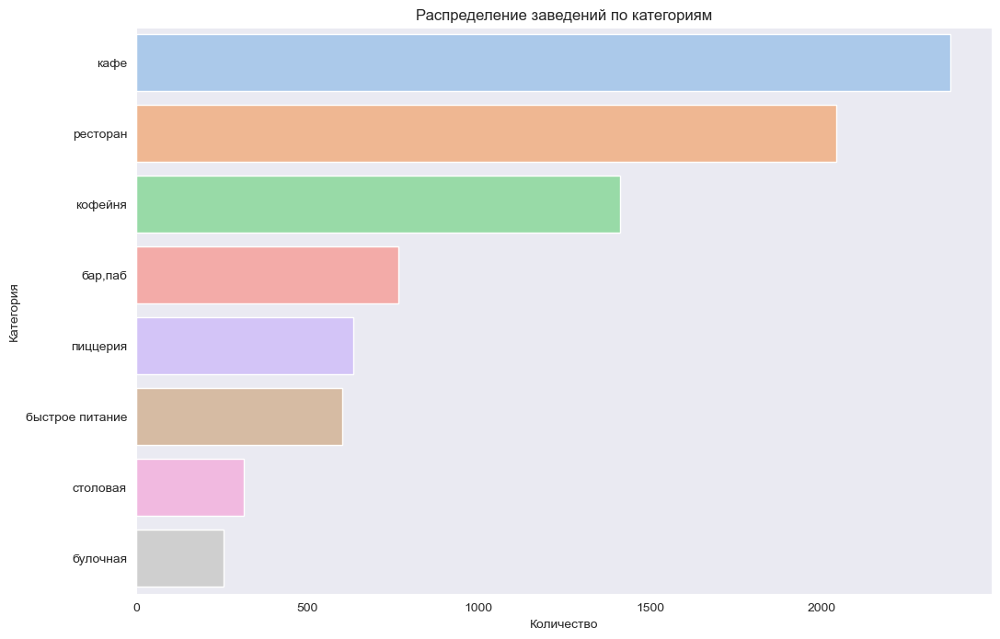

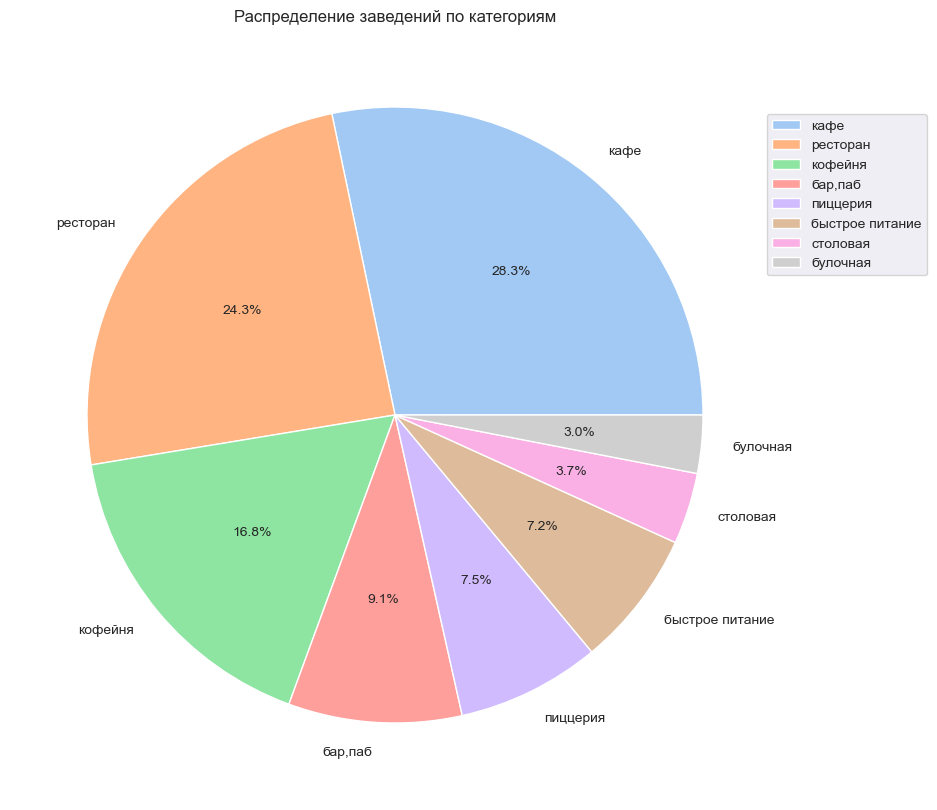

 
Количество заведений по категориям: 


,Категория,Количество,"Доля, %"
3,кафе,2378,28.3
6,ресторан,2043,24.3
4,кофейня,1413,16.8
0,"бар,паб",765,9.1
5,пиццерия,633,7.5
2,быстрое питание,603,7.2
7,столовая,315,3.7
1,булочная,256,3.0


Количество категорий заведений:  8 
Количество заведений:  8406 


In [67]:
# Подсчет количества заведений по категориям
category_cnt = df_filled.groupby('category').agg({'name': 'count'}).reset_index().sort_values(by='name', ascending=False)
category_cnt.columns = ['Категория', 'Количество']
category_cnt['Доля, %'] = round(category_cnt['Количество'] / len(df_filled) * 100, 1)

# График распределения событий по категориям
plt.figure(figsize=(12, 8))
plt.title('Распределение заведений по категориям')
sns.barplot(x='Количество', y='Категория', data=category_cnt)
plt.show()

# Круговая диаграмма
df_filled.groupby('category').agg({'name':'count'}).sort_values(by='name', ascending=False).plot(
    y='name', kind='pie', figsize=(10, 10), autopct='%1.1f%%')
plt.legend(bbox_to_anchor=(0.6, 0, 0.6, 0.9)) # Расположение легенды на графике
plt.ylabel('')
plt.title('Распределение заведений по категориям') 
plt.show()

# Таблица с количеством заведений по категориям
print(clr_g, '\nКоличество заведений по категориям:', clr_b)
display(category_cnt)
print('Количество категорий заведений:', clr_g, len(category_cnt), clr_b)
print('Количество заведений:', clr_g, len(df_filled), clr_b)

В данных представлены 8 категорий заведений. В тройку лидеров входят:
- `кафе`, 28,3 % 
- `ресторан`, 24.3 %
- `кофейня`, 16.8 %
Категории `бар,паб`, `пиццерия` и `быстрое питание` составляют менее 10 % каждая.
Булочных и столовых немного, 3-4 %

<a id='analysis_2'></a>
### Количество посадочных мест по категориям

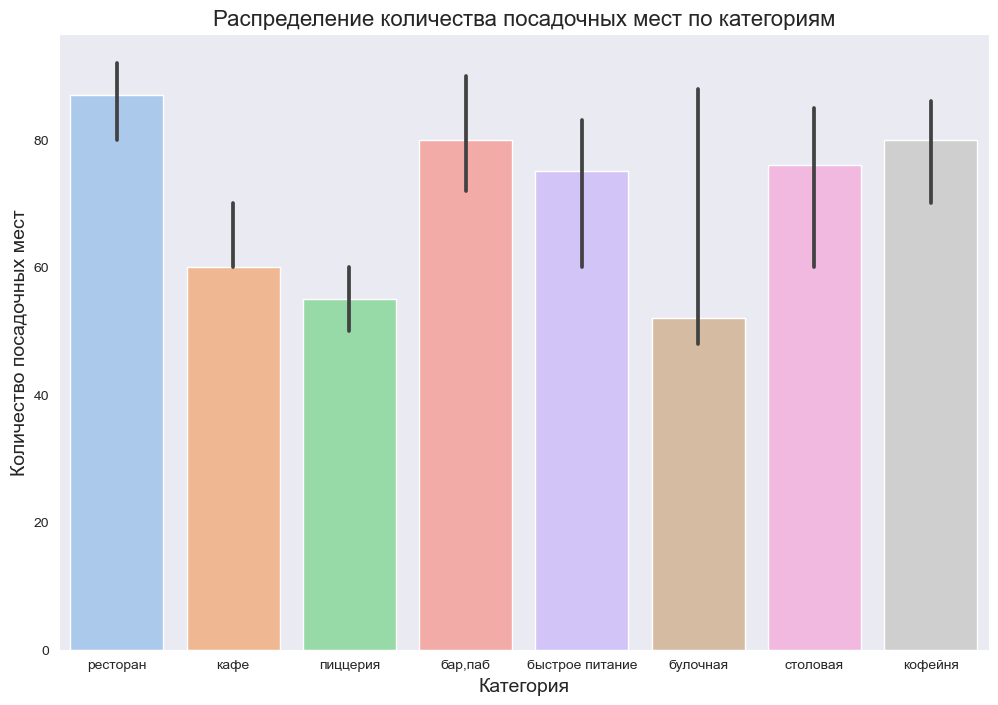

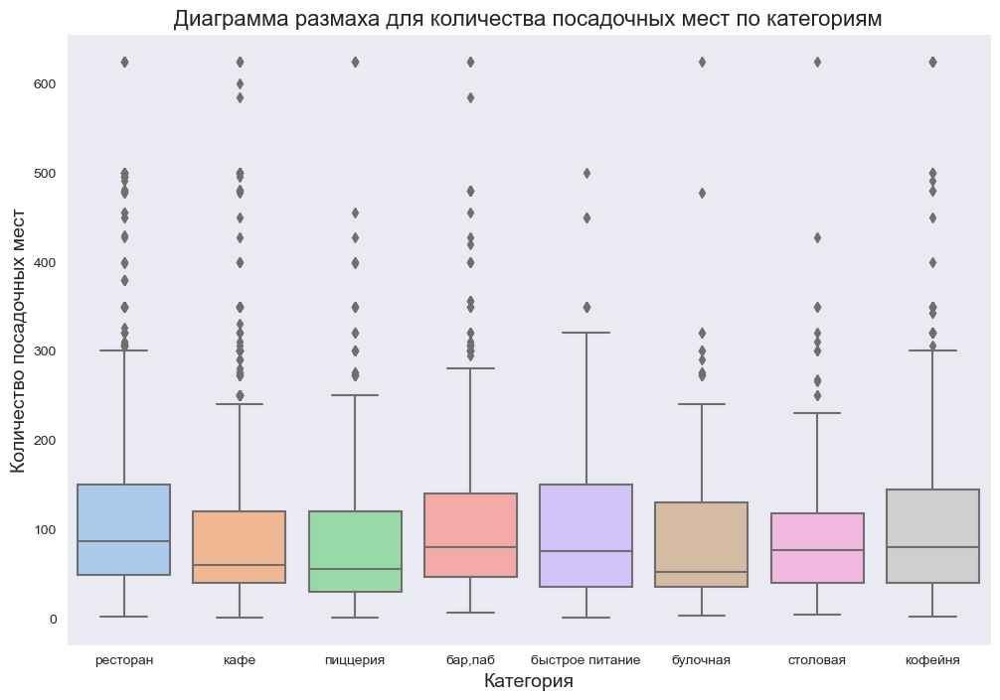

 
Медианное количество посадочных мест по категориям: 


,Категория,Медианное количество посадочных мест
6,ресторан,87
0,"бар,паб",80
4,кофейня,80
7,столовая,76
2,быстрое питание,75
3,кафе,60
5,пиццерия,55
1,булочная,52


In [68]:
# Распределение количества посадочных мест по категориям
plt.figure(figsize=(12, 8))
plt.title('Распределение количества посадочных мест по категориям', fontsize = 16)
ax = sns.barplot(data=df_filled.query('seats != 0'), y='seats', x='category', estimator=np.median)
plt.xlabel('Категория', fontsize = 14)
plt.ylabel('Количество посадочных мест', fontsize = 14)
plt.show()

# Диаграмма размаха для количества посадочных мест по категориям
plt.figure(figsize=(12, 8))
plt.title('Диаграмма размаха для количества посадочных мест по категориям', fontsize = 16)
sns.boxplot(y='seats', x='category', data=df_filled.query('seats != 0'))
plt.xlabel('Категория', fontsize = 14)
plt.ylabel('Количество посадочных мест', fontsize = 14)
plt.show()

# Подсчет среднего количества посадочных по категориям
category_cnt = df_filled.query('seats != 0').groupby('category').agg({'seats': 'median'}).reset_index(
).sort_values(by='seats', ascending=False)
category_cnt['seats'] = category_cnt['seats'].round().astype(int)
category_cnt.columns = ['Категория', 'Медианное количество посадочных мест']
print(clr_g, '\nМедианное количество посадочных мест по категориям:', clr_b)
display(category_cnt)

В целом, заведения не сильно варьируются по числу посадочных мест. По среднему количеству посадочных мест лидируют категории:
- `ресторан` (87)
- `бар, паб` (80)
- `кофейня` (80)

<a id='analysis_3'></a>
### Соотношение сетевых и несетевых заведений

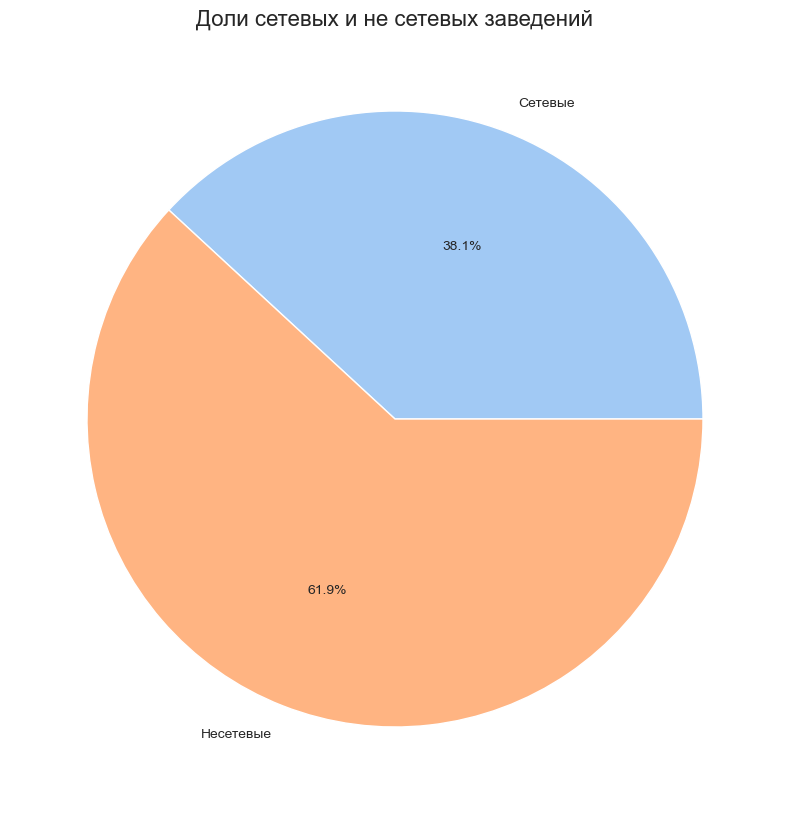

 
Доли сетевых и не сетевых заведений:


,Количество,"Доля, %"
Сетевые заведения,3205,38.1
Несетевые заведения,5201,61.9


In [69]:
name_chain = df_filled.query('chain == 1') # Сетевые заведения
name_unchain = df_filled.query('chain == 0') # Несетевые заведения

# Создание таблицы с долями сетевых и не сетевых заведений
c = []
c.append(len(name_chain))
c.append(len(name_unchain))
chain = pd.DataFrame(c, index=['Сетевые заведения', 'Несетевые заведения'], columns=['Количество'])
chain['Доля, %'] = round(chain['Количество'] / len(df_filled) * 100, 1)

# Круговая диаграмма
plt.figure(figsize=(10, 10))
plt.title('Доли сетевых и не сетевых заведений', fontsize = 16)
plt.pie(chain['Количество'], labels=['Сетевые', 'Несетевые'], autopct='%1.1f%%')
plt.show()

#Вывод таблицы
print(clr_g, '\nДоли сетевых и не сетевых заведений:')
display(chain)

Основная масса заведений общественного питания в Москве не сетевые, **61,9 %**.

<a id='analysis_4'></a>
### Распределение сетевых заведений по категориям

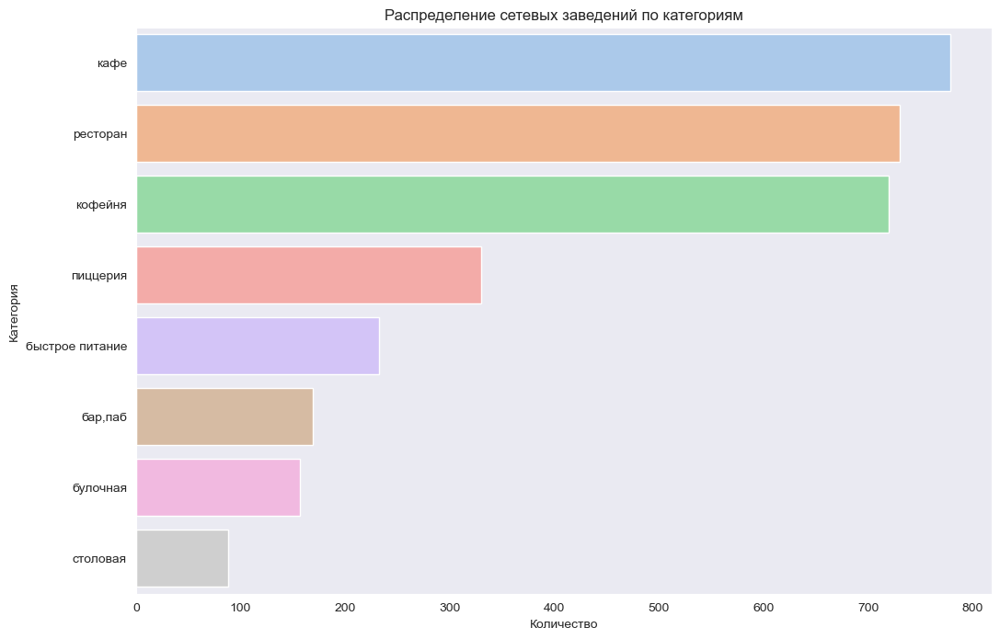

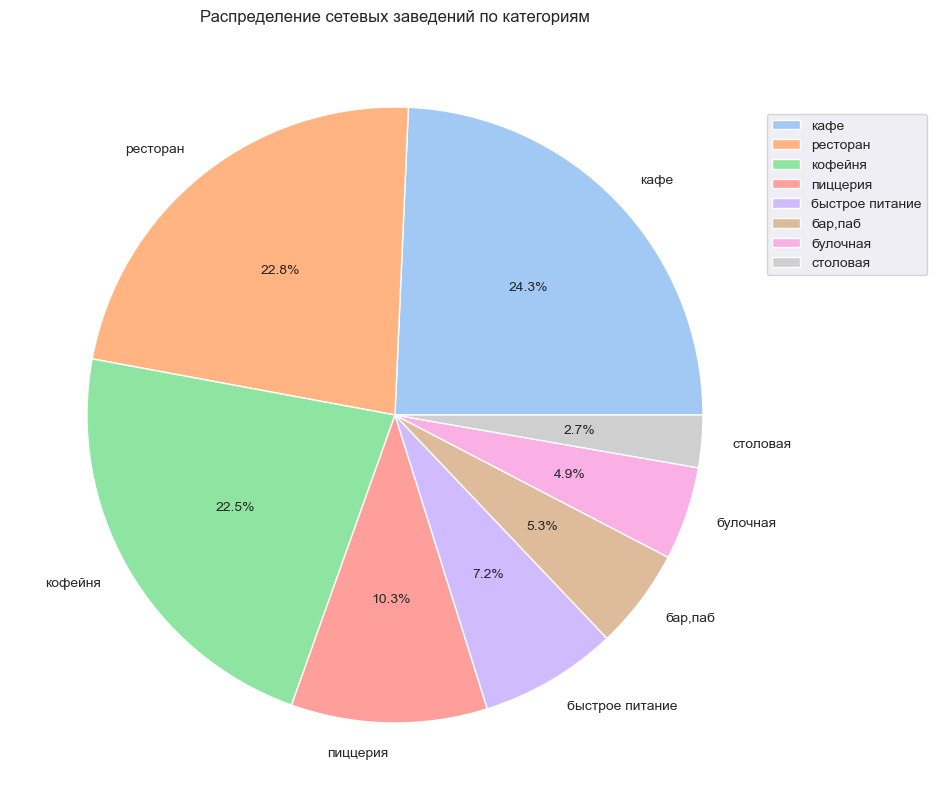

 
Количество сетевых заведений по категориям: 


,Категория,Количество,"Доля, %"
3,кафе,779,24.3
6,ресторан,730,22.8
4,кофейня,720,22.5
5,пиццерия,330,10.3
2,быстрое питание,232,7.2
0,"бар,паб",169,5.3
1,булочная,157,4.9
7,столовая,88,2.7


Количество категорий заведений:  8 
Количество сетевых заведений:  3205 


In [70]:
# Подсчет количества заведений по категориям
category_cnt = name_chain.groupby('category').agg({'name': 'count'}).reset_index().sort_values(by='name', ascending=False)
category_cnt.columns = ['Категория', 'Количество']
category_cnt['Доля, %'] = round(category_cnt['Количество'] / len(name_chain) * 100, 1)

# График распределения событий по категориям
plt.figure(figsize=(12, 8))
plt.title('Распределение сетевых заведений по категориям')
sns.barplot(x='Количество', y='Категория', data=category_cnt)
plt.show()

# Круговая диаграмма
name_chain.groupby('category').agg({'name':'count'}).sort_values(by='name', ascending=False).plot(
    y='name', kind='pie', figsize=(10, 10), autopct='%1.1f%%')
plt.legend(bbox_to_anchor=(0.6, 0, 0.6, 0.9)) # Расположение легенды на графике
plt.ylabel('')
plt.title('Распределение сетевых заведений по категориям') 
plt.show()

# Таблица с количеством заведений по категориям
print(clr_g, '\nКоличество сетевых заведений по категориям:', clr_b)
display(category_cnt)
print('Количество категорий заведений:', clr_g, len(category_cnt), clr_b)
print('Количество сетевых заведений:', clr_g, len(name_chain), clr_b)

Чаще оказываются сетевыми заведения из категорий `кафе`, `ресторан`, `кофейня`. Доли примерно одинаковы, **22,5 - 24,3 %**.

 
Количество сетевых и несетевых заведений по категориям: 



,Категория,Количество сетевых,Количество несетевых,Всего,"Доля сетевых, %"
1,булочная,157,99,256,61.3
5,пиццерия,330,303,633,52.1
4,кофейня,720,693,1413,51.0
2,быстрое питание,232,371,603,38.5
6,ресторан,730,1313,2043,35.7
3,кафе,779,1599,2378,32.8
7,столовая,88,227,315,27.9
0,"бар,паб",169,596,765,22.1


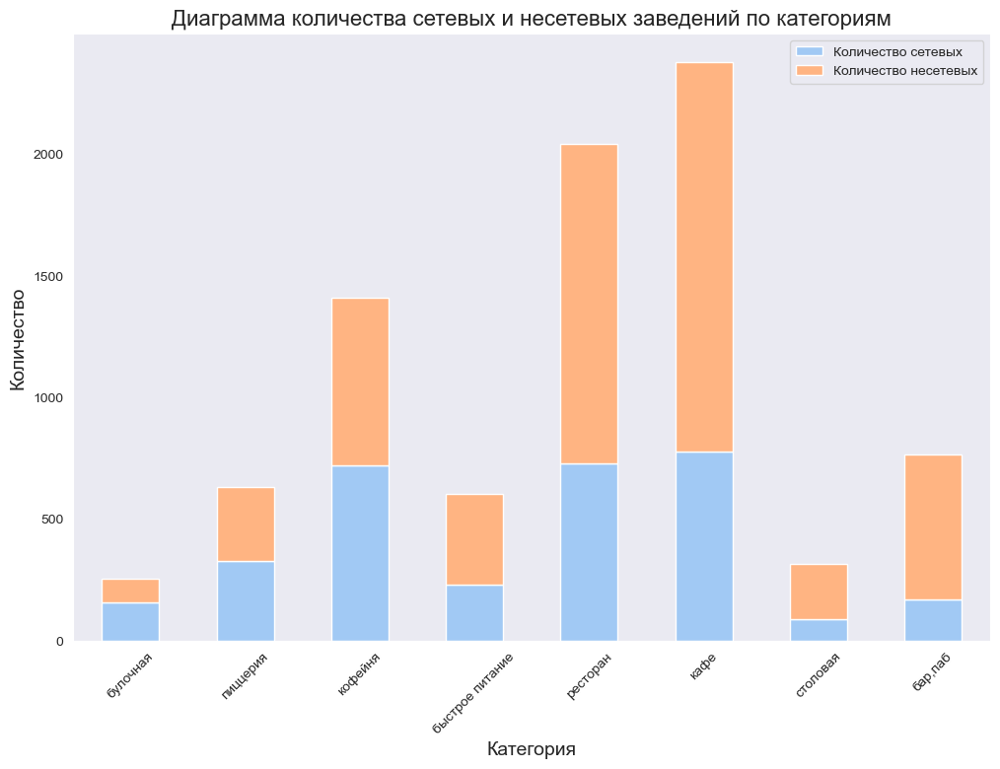

In [71]:
# Таблица с количество сетевых заведений и долей сетевых от общего количества по категориям
df_chain = df_filled.query('chain == 1').groupby('category', as_index=False)['address'].count()
df_chain.columns = ['category', 'chain_cnt']
df_unchain = df_filled.query('chain == 0').groupby('category', as_index=False)['address'].count()
df_unchain.columns = ['category', 'unchain_cnt']
df_chain = df_chain.merge(df_unchain, on='category', how='inner')
df_chain['total'] = df_chain['chain_cnt'] + df_chain['unchain_cnt']
df_chain['ratio'] = round(df_chain['chain_cnt'] / df_chain['total'] * 100 ,1)
df_chain = df_chain.sort_values(by='ratio', ascending=False)
df_chain.columns = ['Категория', 'Количество сетевых', 'Количество несетевых', 'Всего', 'Доля сетевых, %']
print(clr_g, '\nКоличество сетевых и несетевых заведений по категориям:', clr_b)
print()
display(df_chain)

# Диаграмма с накоплением
df_chain = df_chain.drop(columns = ['Всего', 'Доля сетевых, %'])
df_chain.set_index('Категория').plot(kind='bar', stacked=True, figsize=(12, 8))
plt.title('Диаграмма количества сетевых и несетевых заведений по категориям', fontsize=16)
plt.xlabel('Категория', fontsize=14)
plt.ylabel('Количество', fontsize=14)
plt.xticks(rotation=45)
plt.show();

**Вывод:**

Чаще оказываются сетевыми заведения из категорий `булочная` (61%), `пиццерия` (52 %) и `кофейня` (51 %).

<a id='analysis_5'></a>
### Самые популярные сетевые заведения в Москве

In [72]:
# Топ 15 популярных сетевых заведений.
top15_chains = df_filled.query('chain == 1').groupby('name').agg(
    {
        'rating': 'mean', 
        'category': 'unique', 
        'address': 'count', 
        'seats': 'mean',
        'middle_avg_bill': 'mean',
        'district': 'count'
    }).reset_index().sort_values(by='rating', ascending=False)
top15_chains.columns = [
    'Название сети', 
    'Средний рейтинг', 
    'Категория', 
    'Количество точек', 
    'Количество мест',
    'Средний счет',
    'Количество округов'
    ]
top15_chains = top15_chains.head(15)
top15_chains

,Название сети,Средний рейтинг,Категория,Количество точек,Количество мест,Средний счет,Количество округов
281,весна,4.90,[кафе],2,0.000000,0.000000,2
396,ком 1989,4.90,[кафе],2,110.000000,0.000000,2
68,drive,4.90,[кафе],1,92.000000,0.000000,1
245,барбариста,4.90,[кофейня],2,13.000000,0.000000,2
240,баку,4.90,[кафе],1,75.000000,0.000000,1
207,we cidreria,4.90,"[бар,паб]",2,140.000000,0.000000,2
480,мясо на углях,4.90,[кафе],1,0.000000,0.000000,1
20,boston seafood & bar,4.90,[ресторан],2,103.000000,2250.000000,2
16,bigсуши,4.90,[кафе],1,0.000000,0.000000,1
422,ла гатта,4.90,[пиццерия],3,68.333333,491.666667,3


Среди самых популярных сетевых заведений Москвы не встречаются общеизвестные сети с большим количеством точек, такие как, например, `Му-Му` или `Теремок`. Из ТОП 15 по популярности заведений болшинство имеют в городе 1 (видимо, есть еще в других городах) или 2 точки и только две сети 3 и 5 точек, `Ла Гатта` и `Хинккали-Gали!`,соответственно. Если точек 2 и более, они располагаются в разных округах. Информации о среднем счете и количестве мест не достаточно, из того что имеется можно сделать вывод, что эти параметры сильно различаются для разных сетей. По категоряим преобладают `кафе`. Необходимо изучить распределение категорий популярных сетей по округам.

In [73]:
# Список категорий сетей ТОП15 по популярности
top15_chains_categories = ['кафе', 'бар,паб', 'ресторан', 'пиццерия', 'быстрое питание']

In [74]:
# Создание талбицы с общим количеством заведений по округам
df_district = df_filled.query('chain == 1').groupby('district')['name'].count().reset_index().sort_values(by='name', ascending=False)
df_district.columns = ['Округ', 'Всего заведений']

# Список округов
districts = list(df_district['Округ'])

# Добавление столбцов с количеством заведений по категориям
for i in range(len(top15_chains_categories)):
    a = []
    for j in range(len(districts)):
        a.append(
            df_filled.query('chain == 1').loc[
                (df_filled.query('chain == 1')['district'] == districts[j]) & (df_filled.query('chain == 1')['category'] == top15_chains_categories[i]),
                'address'].count())
    df_district.insert(loc = i+1, column = top15_chains_categories[i], value = a )

# Укорачиваем названия округов
df_district['Округ'] = ['ЦАО', 'САО', 'ЮАО', 'СВАО', 'ЗАО', 'ВАО', 'ЮВАО', 'ЮЗАО', 'СЗАО'] 
    
print(clr_g, '\nОбщее количество сетевых заведений и количество сетевых заведений по категориям \nиз ТОП15 сетевых заведений по округам:', clr_b)
display(df_district)

 
Общее количество сетевых заведений и количество сетевых заведений по категориям 
из ТОП15 сетевых заведений по округам: 


,Округ,кафе,"бар,паб",ресторан,пиццерия,быстрое питание,Всего заведений
5,ЦАО,218,73,217,48,34,875
1,САО,85,8,90,38,33,376
2,ЮАО,66,20,66,40,20,347
3,СВАО,83,18,61,36,27,334
8,ЗАО,59,16,83,41,24,312
7,ВАО,80,11,72,38,30,302
0,ЮВАО,73,11,63,38,28,283
6,ЮЗАО,80,10,41,29,23,220
4,СЗАО,35,2,37,22,13,156


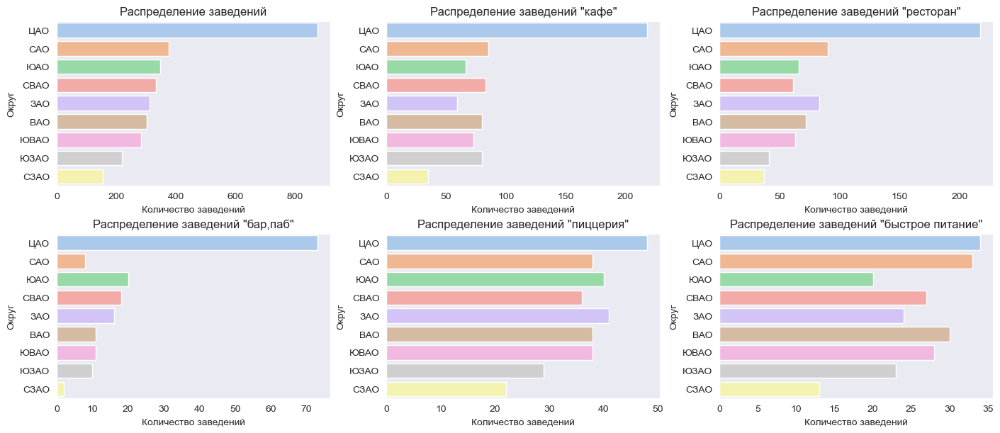

In [75]:
# Распределение заведений популярных категорий по административным окгругам.
fg = plt.figure(figsize=(14, 6), constrained_layout=True)
gs = gridspec.GridSpec(ncols=3, nrows=2, figure=fg)
fig_ax_1 = fg.add_subplot(gs[0, 0])
sns.barplot(x='Всего заведений', y='Округ', data=df_district).set(
    title='Распределение заведений',
    xlabel = 'Количество заведений',
    ylabel = 'Округ'
    )
fig_ax_2 = fg.add_subplot(gs[0, 1])
sns.barplot(x='кафе', y='Округ', data=df_district).set(
    title='Распределение заведений "кафе"',
    xlabel = 'Количество заведений',
    ylabel = 'Округ'
    );
fig_ax_3 = fg.add_subplot(gs[0, 2])
sns.barplot(x='ресторан', y='Округ', data=df_district).set(
    title='Распределение заведений "ресторан"',
    xlabel = 'Количество заведений',
    ylabel = 'Округ'
    );
fig_ax_4 = fg.add_subplot(gs[1, 0])
sns.barplot(x='бар,паб', y='Округ', data=df_district).set(
    title='Распределение заведений "бар,паб"',
    xlabel = 'Количество заведений',
    ylabel = 'Округ'
    );
fig_ax_5 = fg.add_subplot(gs[1, 1])
sns.barplot(x='пиццерия', y='Округ', data=df_district).set(
    title='Распределение заведений "пиццерия"',
    xlabel = 'Количество заведений',
    ylabel = 'Округ'
    );
fig_ax_6 = fg.add_subplot(gs[1, 2])
sns.barplot(x='быстрое питание', y='Округ', data=df_district).set(
    title='Распределение заведений "быстрое питание"',
    xlabel = 'Количество заведений',
    ylabel = 'Округ'
    );


Большое количество сетевых заведений всех категорий находится в Центральном административном округе, к этой локации тяготеют заведения категорий `бар,паб`, `кафе` и `ресторан`. Выглядит недостаточно охваченным заведениями общественного питания Северо-Западный административный округ, не смотря на то, что в него входят зоны отдыха `Серебряный бор` и `Строгино`, а также крупный "спальный" район `Митино`.

**Общий вывод по анализу популярных сетевых заведений Москвы:**
- Из ТОП 15 по популярности заведений болшинство имеют в городе 1 или 2 точки
- Если точек 2 и более, они располагаются в разных районах города
- По категоряим преобладают `кафе`
- большое количество заведений всех категорий находится в ЦАО
- недостаточно охвачен заведениями общепита СЗАО

<a id='analysis_6'></a>
### Распределение заведений по районам Москвы


В данных присутствует информация по административным округам Москвы:  9 
 
Перечень административных округов: 
Центральный административный округ
Северный административный округ
Южный административный округ
Северо-Восточный административный округ
Западный административный округ
Восточный административный округ
Юго-Восточный административный округ
Юго-Западный административный округ
Северо-Западный административный округ
 
Общее количество заведений и количество заведений каждой категории по округам: 


,Округ,кафе,ресторан,кофейня,пиццерия,"бар,паб",быстрое питание,булочная,столовая,Всего заведений
5,ЦАО,464,670,428,113,364,87,50,66,2242
2,САО,235,189,193,77,68,58,39,41,900
8,ЮАО,264,202,131,73,68,85,25,44,892
3,СВАО,269,182,159,68,63,82,28,40,891
1,ЗАО,239,218,150,71,50,62,37,24,851
0,ВАО,272,160,105,72,53,71,25,40,798
6,ЮВАО,282,145,89,55,38,67,13,25,714
7,ЮЗАО,238,168,96,64,38,61,27,17,709
4,СЗАО,115,109,62,40,23,30,12,18,409


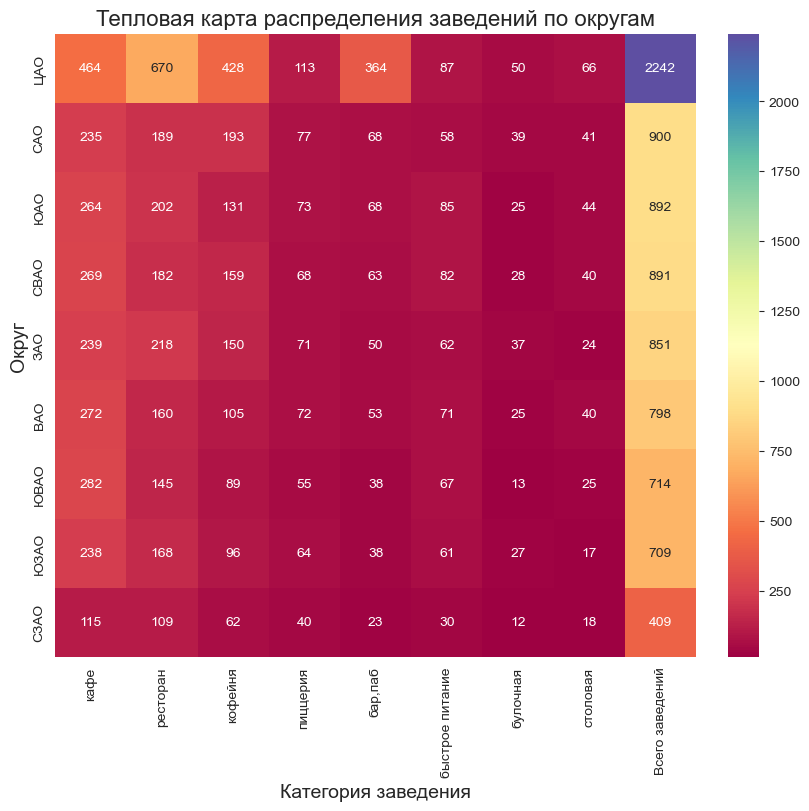

In [76]:
# Выводим названия административных округов 
print('\nВ данных присутствует информация по административным округам Москвы:', clr_g, df_filled['district'].nunique(), clr_b)
print(clr_g, '\nПеречень административных округов:', clr_b) 

# Создание талбицы с общим количеством заведений по округам
df_district = df_filled.groupby('district')['name'].count().reset_index().sort_values(by='name', ascending=False)
df_district.columns = ['Округ', 'Всего заведений']

# Список округов
districts = list(df_district['Округ'])

# Печатаем перечень округов
for i in range(len(districts)):
    print(districts[i])

# Список категорий
categories = list(df_filled['category'].unique())

# Добавление столбцов с количеством заведений по категориям
for i in range(len(categories)):
    a = []
    for j in range(len(districts)):
        a.append(
            df_filled.loc[
                (df_filled['district'] == districts[j]) & (df_filled['category'] == categories[i]),
                'address'].count())
    df_district.insert(loc = i+1, column = categories[i], value = a )

# Укорачиваем названия округов
df_district['Округ'] = ['ЦАО', 'САО', 'ЮАО', 'СВАО', 'ЗАО', 'ВАО', 'ЮВАО', 'ЮЗАО', 'СЗАО'] 
    
print(clr_g, '\nОбщее количество заведений и количество заведений каждой категории по округам:', clr_b)
display(df_district)

# Построение зависимостей
df_district = df_district.set_index('Округ') # Делаем из столбца 'Округ' индекс
fg = plt.figure(figsize=(8, 8), constrained_layout=True)
sns.heatmap(df_district, cmap = 'Spectral', annot = True, fmt = 'd')
plt.xlabel('Категория заведения', fontsize = 14) 
plt.ylabel('Округ', fontsize = 14)
plt.title('Тепловая карта распределения заведений по округам', fontsize = 16);

**Общий вывод по распределению заведений по районам Москвы:**
- В целом болше всего заведений категории `ресторан`. ТОП 5 категорий: `ресторан` (670), `кафе` (464), `кофейня` (428), `бар,паб` (364), `пиццерия` (113).
- большое количество заведений всех категорий находится в ЦАО
- недостаточно охвачен заведениями общепита СЗАО

<a id='analysis_7'></a>
### Средние рейтинги по категориям заведений

 
Средний рейтинг в зависимости от категории заведения


,Категория,Рейтинг
0,"бар,паб",4.39
5,пиццерия,4.30
6,ресторан,4.29
4,кофейня,4.28
1,булочная,4.27
7,столовая,4.21
3,кафе,4.12
2,быстрое питание,4.05


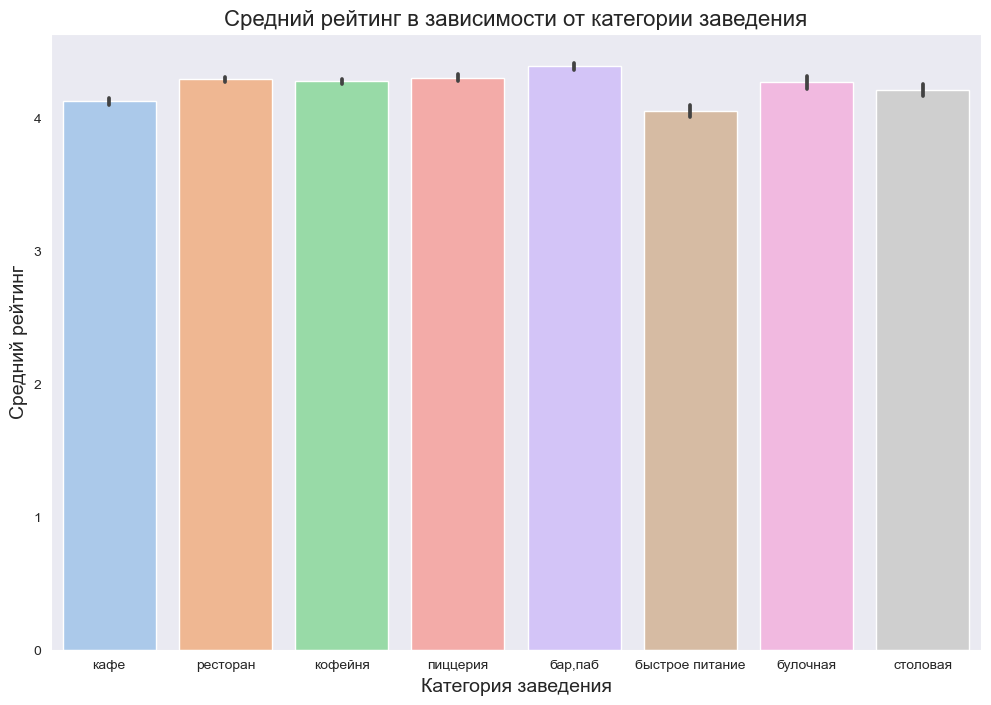

In [77]:
# Строим гистограмму распределения средних рейтингов по категориям заведений
plt.figure(figsize=(12,8))
sns.barplot(data=df_filled, x='category', y='rating')
plt.title('Средний рейтинг в зависимости от категории заведения', fontsize = 16)
plt.xlabel('Категория заведения', fontsize = 14)
plt.ylabel('Средний рейтинг', fontsize = 14)

# Строим таблицу со средними рейтингами в зависимости от категории заведения
cnt_rating = df_filled.groupby('category')['rating'].mean().reset_index().sort_values(by='rating', ascending=False)
cnt_rating.columns = ['Категория', 'Рейтинг']
cnt_rating['Рейтинг'] = round(cnt_rating['Рейтинг'], 2)
print(clr_g, '\nСредний рейтинг в зависимости от категории заведения')
display(cnt_rating)

Лидер по среднему рейтингу заведений - категория `бар,паб`. `Пиццерии`, `рестораны` и `кофейни` практически не отличаются по среднему рейтингу заведений. Самый невысокий средний рейтинг в категории `быстрое питание`.

<a id='analysis_8'></a>
### Фоновая картограмма со средним рейтингом заведений каждого района

In [78]:
# Расчет среднего рейтинга заведений по районам
rating_by_district = df_filled.groupby('district', as_index=False)['rating'].mean()
rating_by_district['rating'] = round(rating_by_district['rating'], 2)
rating_by_district

,district,rating
0,Восточный административный округ,4.17
1,Западный административный округ,4.18
2,Северный административный округ,4.24
3,Северо-Восточный административный округ,4.15
4,Северо-Западный административный округ,4.21
5,Центральный административный округ,4.38
6,Юго-Восточный административный округ,4.10
7,Юго-Западный административный округ,4.17
8,Южный административный округ,4.18


In [79]:
# Загружаем данные о географических границах округов Москвы в переменную
with open(path_geo, encoding='utf-8') as f:
    msk_geo = json.load(f)
    
print(json.dumps(msk_geo, indent=2, ensure_ascii=False, sort_keys=True))

{
  "features": [
    {
      "geometry": {
        "coordinates": [
          [
            [
              [
                37.8756653,
                55.825342400000004
              ],
              [
                37.876001599999995,
                55.8249027
              ],
              [
                37.8730967,
                55.8237936
              ],
              [
                37.8689418,
                55.8228697
              ],
              [
                37.869206999999996,
                55.822363200000005
              ],
              [
                37.868322500000005,
                55.822211100000004
              ],
              [
                37.867472,
                55.823703
              ],
              [
                37.86851090000001,
                55.82391880000001
              ],
              [
                37.87046039999999,
                55.8242706
              ],
              [
                37.87172779999

In [80]:
 
msk_lat, msk_lng = 55.751244, 37.618423 # Задаем широту и долготу центра Москвы

m = Map(location=[msk_lat, msk_lng], zoom_start=10) # Создаем карту Москвы

# Создаем хороплет и добавляем его на карту

Choropleth(
    geo_data = msk_geo,
    data = rating_by_district,
    columns = ['district', 'rating'],
    key_on = 'feature.name',
    fill_color = 'YlGn',
    fill_opacity = 0.8,
    legend_name = 'Средний рейтинг заведений по районам'
    ).add_to(m)

m # Вывод карты

Лидер по рейтингу заведений - Центральный административный округ, самый низкий средний рейтинг заведений в юго-восточноам округе.

<a id='analysis_9'></a>
### Карта Москвы с заведениями общественного питания

In [81]:
m = Map(location=[msk_lat, msk_lng], zoom_start=10) # Создаем карту Мск
marker_cluster = MarkerCluster().add_to(m) # Добавляем на карту пустой маркер

# Функция для создания кластеорв
def creat_clusters(row):
    icon_url = 'https://img.icons8.com/ios/50/null/food-bar.png' # Иконка для ресторана
    icon = CustomIcon(icon_url, icon_size=(30, 30)) # Объект с иконкой 30х30
    
    # Создаем маркер с иконкой и добавляем его на карту
    Marker(
        [row['lat'], row['lng']],
        popup = f"{row['name']} {row['rating']}",
        icon = icon,
        ).add_to(marker_cluster)

# Применяем функцию к таблице
df_filled.apply(creat_clusters, axis=1)

# Вывод карты
m

<a id='analysis_10'></a>
### Улицы с наибольшим количеством заведений общественного питания

 
ТОП15 улиц по количеству заведений: 


,Улица,Количество заведений
544,проспект мира,184
1213,улица профсоюзная,122
530,проспект вернадского,108
538,проспект ленинский,107
537,проспект ленинградский,95
1426,шоссе дмитровское,88
1431,шоссе каширское,77
1422,шоссе варшавское,76
1433,шоссе ленинградское,70
80,мкад,65


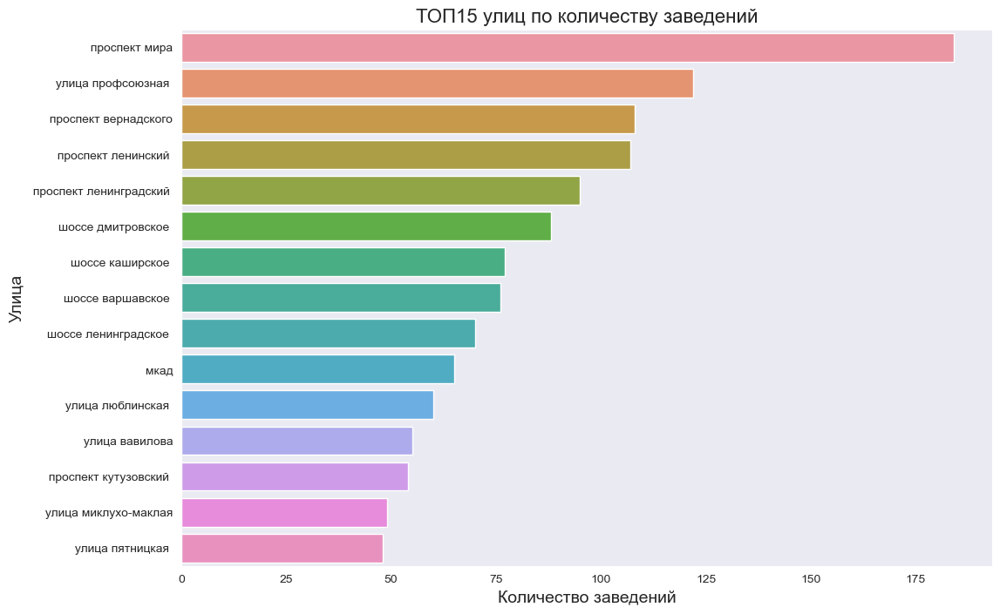

In [82]:
# Талбица для ТОП15 улиц по количеству заведений
top15_streets = df_filled.groupby('street', as_index=False)['address'].count().sort_values(by='address', ascending=False)
top15_streets = top15_streets.head(15)
top15_streets.columns = ['Улица', 'Количество заведений']
print(clr_g, '\nТОП15 улиц по количеству заведений:', clr_b )
display(top15_streets)

# Визуализация
plt.figure(figsize=(12,8))
sns.barplot(data=top15_streets, x='Количество заведений', y='Улица')
plt.title('ТОП15 улиц по количеству заведений', fontsize = 16)
plt.xlabel('Количество заведений', fontsize = 14)
plt.ylabel('Улица', fontsize = 14);

В ТОП15 улиц по количеству заведений попали протяженные улицы (шоссе и проспекты), из улиц в центре только Пятницкая.

 
Общее количество заведений и количество заведений каждой категории по ТОП15 улицам: 


,Улица,кафе,ресторан,кофейня,пиццерия,"бар,паб",быстрое питание,булочная,столовая,Количество заведений
544,проспект мира,53,45,36,11,12,21,4,2,184
1213,улица профсоюзная,35,26,18,15,6,15,4,3,122
530,проспект вернадского,25,33,16,12,7,12,1,2,108
538,проспект ленинский,26,33,23,5,10,2,3,5,107
537,проспект ленинградский,12,25,25,9,15,2,4,3,95
1426,шоссе дмитровское,23,24,11,8,6,10,2,4,88
1431,шоссе каширское,20,19,16,5,2,10,0,5,77
1422,шоссе варшавское,18,20,14,4,6,7,0,7,76
1433,шоссе ленинградское,13,26,13,3,5,5,2,3,70
80,мкад,45,5,4,0,1,9,0,1,65


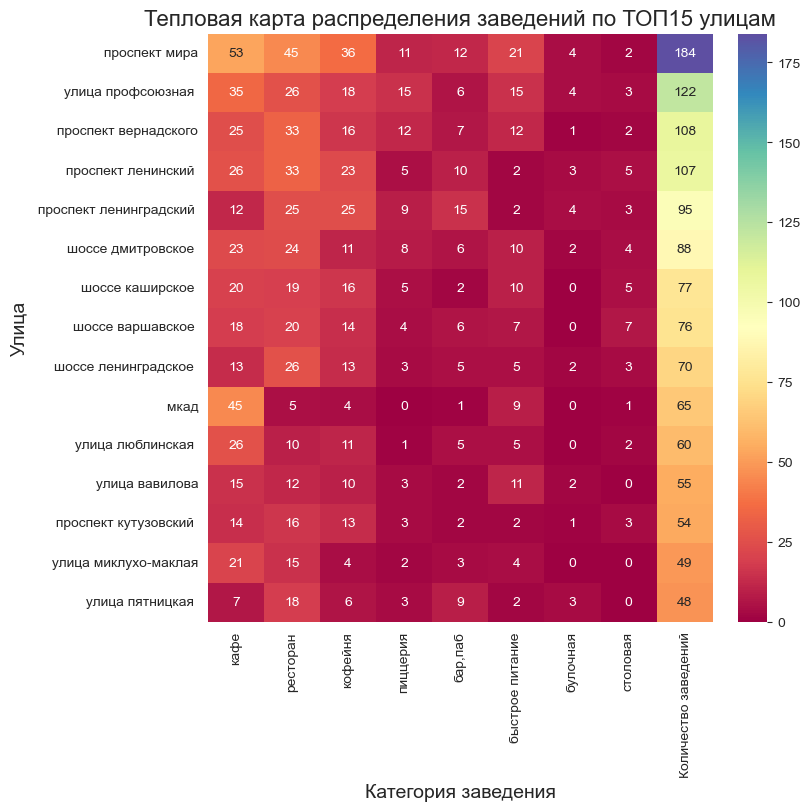

In [83]:
# Распределение категорий по ТОП15 улицам

# Список улиц
top15_streets_list = list(top15_streets['Улица'])

# Список категорий задан ранее, categories

# Добавление столбцов с количеством заведений по категориям
for i in range(len(categories)):
    a = []
    for j in range(len(top15_streets_list)):
        a.append(
            df_filled.loc[
                (df_filled['street'] == top15_streets_list[j]) & (df_filled['category'] == categories[i]),
                'address'].count())
    top15_streets.insert(loc = i+1, column = categories[i], value = a )
  
print(clr_g, '\nОбщее количество заведений и количество заведений каждой категории по ТОП15 улицам:', clr_b)
display(top15_streets)

# Построение зависимостей
top15_streets = top15_streets.set_index('Улица') # Делаем из столбца 'Улица' индекс
fg = plt.figure(figsize=(8, 8), constrained_layout=True)
sns.heatmap(top15_streets, cmap = 'Spectral', annot = True, fmt = 'd')
plt.xlabel('Категория заведения', fontsize = 14) 
plt.ylabel('Улица', fontsize = 14)
plt.title('Тепловая карта распределения заведений по ТОП15 улицам', fontsize = 16);

Количество ресторанов на Пятницкой улице сопоставимо с количеством заведений этой категории на гораздо более протяженных магистралях.

<a id='analysis_11'></a>
### Улицы с только одним заведением общепита

In [84]:
# подсчет количества заведений на улицах
adress_cnt = df_filled.groupby('street', as_index=False)['address'].count()
adress_one = adress_cnt.query('address == 1')
adress_one_list = list(adress_one['street'])
print('Количество улиц с одним объектом общепита:', clr_g ,adress_one['address'].count(), clr_b)

Количество улиц с одним объектом общепита:  457 


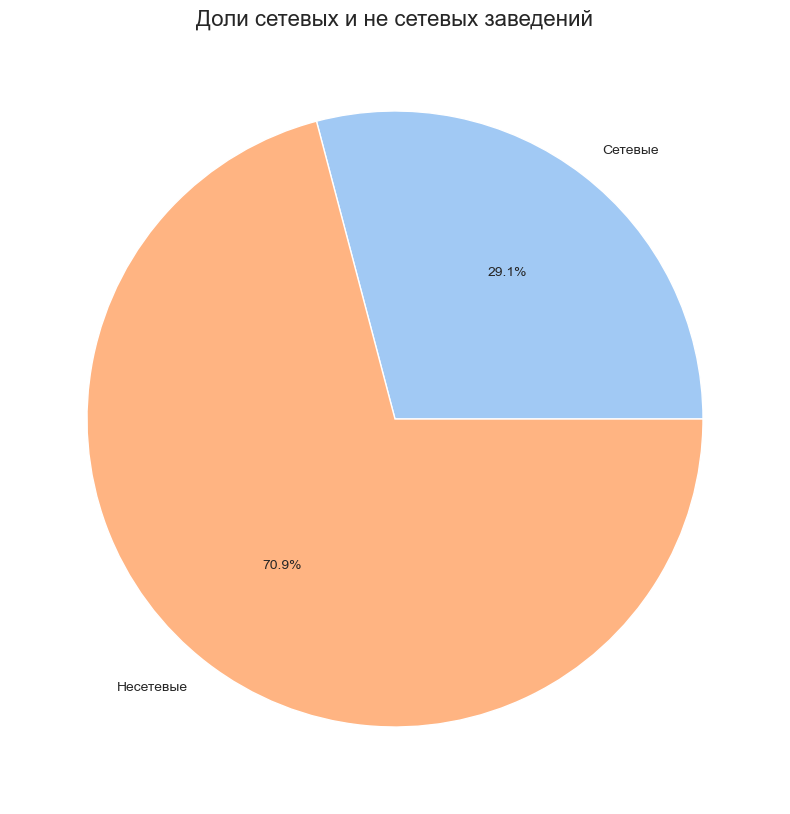

 
Доли сетевых и не сетевых заведений:


,Количество,"Доля, %"
Сетевые заведения,133,29.1
Несетевые заведения,324,70.9


In [85]:
# Создаем таблицу с информацией по улицам с одним объектом общепита
df_adress_one = df_filled.loc[df_filled['street'].isin(adress_one_list) == True]

# Исследуем доли сетевых / не сетевых заведений
name_chain = df_adress_one.query('chain == 1') # Сетевые заведения
name_unchain = df_adress_one.query('chain == 0') # Несетевые заведения

# Создание таблицы с долями сетевых и не сетевых заведений
c = []
c.append(len(name_chain))
c.append(len(name_unchain))
chain = pd.DataFrame(c, index=['Сетевые заведения', 'Несетевые заведения'], columns=['Количество'])
chain['Доля, %'] = round(chain['Количество'] / len(df_adress_one) * 100, 1)

# Круговая диаграмма
plt.figure(figsize=(10, 10))
plt.title('Доли сетевых и не сетевых заведений', fontsize = 16)
plt.pie(chain['Количество'], labels=['Сетевые', 'Несетевые'], autopct='%1.1f%%')
plt.show()

#Вывод таблицы
print(clr_g, '\nДоли сетевых и не сетевых заведений:')
display(chain)

На улицах с одним заведением 29 % объектов сетевые, остальные не сетевые.  В целом по датасету доля сетевых больше (38 %) 

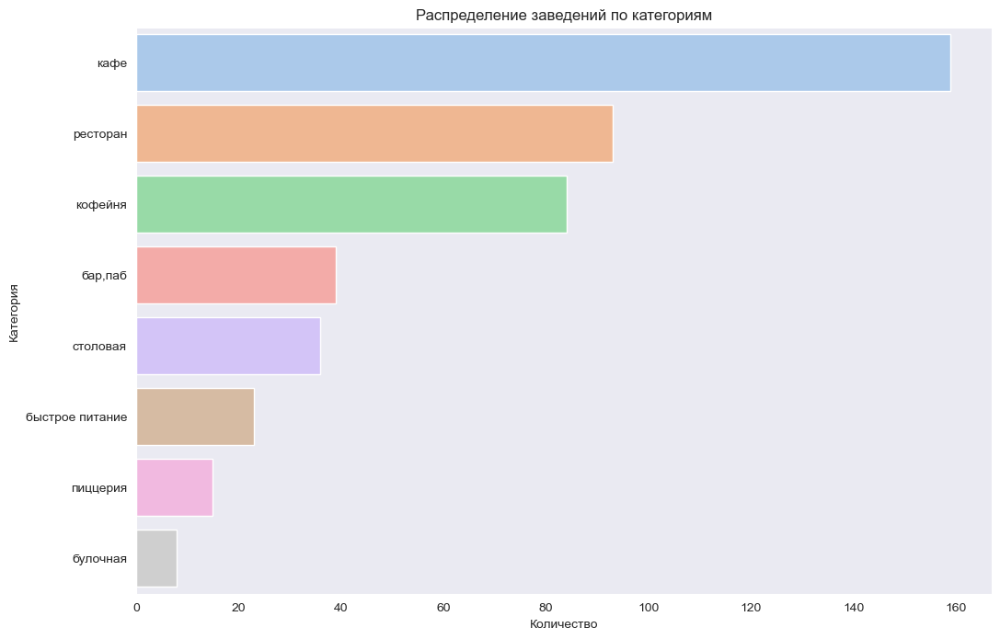

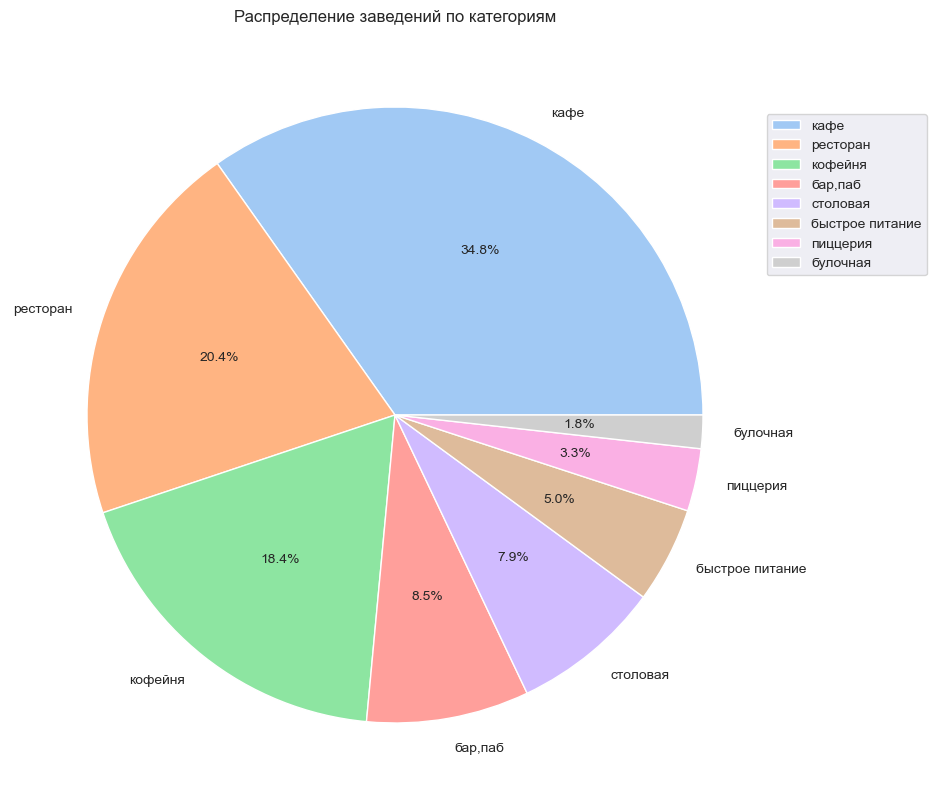

 
Количество заведений по категориям: 


,Категория,Количество,"Доля, %"
3,кафе,159,34.8
6,ресторан,93,20.4
4,кофейня,84,18.4
0,"бар,паб",39,8.5
7,столовая,36,7.9
2,быстрое питание,23,5.0
5,пиццерия,15,3.3
1,булочная,8,1.8


Количество категорий заведений:  8 
Количество заведений:  457 


In [86]:
# Подсчет количества заведений по категориям
category_cnt = df_adress_one.groupby('category').agg({'name': 'count'}).reset_index().sort_values(by='name', ascending=False)
category_cnt.columns = ['Категория', 'Количество']
category_cnt['Доля, %'] = round(category_cnt['Количество'] / len(df_adress_one) * 100, 1)

# График распределения событий по категориям
plt.figure(figsize=(12, 8))
plt.title('Распределение заведений по категориям')
sns.barplot(x='Количество', y='Категория', data=category_cnt)
plt.show()

# Круговая диаграмма
df_adress_one.groupby('category').agg({'name':'count'}).sort_values(by='name', ascending=False).plot(
    y='name', kind='pie', figsize=(10, 10), autopct='%1.1f%%')
plt.legend(bbox_to_anchor=(0.6, 0, 0.6, 0.9)) # Расположение легенды на графике
plt.ylabel('')
plt.title('Распределение заведений по категориям') 
plt.show()

# Таблица с количеством заведений по категориям
print(clr_g, '\nКоличество заведений по категориям:', clr_b)
display(category_cnt)
print('Количество категорий заведений:', clr_g, len(category_cnt), clr_b)
print('Количество заведений:', clr_g, len(df_adress_one), clr_b)

По категориям на первом месте `кафе`, доли `ресторанов` и `кофеен` меньше по сравнению со всем массивом данных.

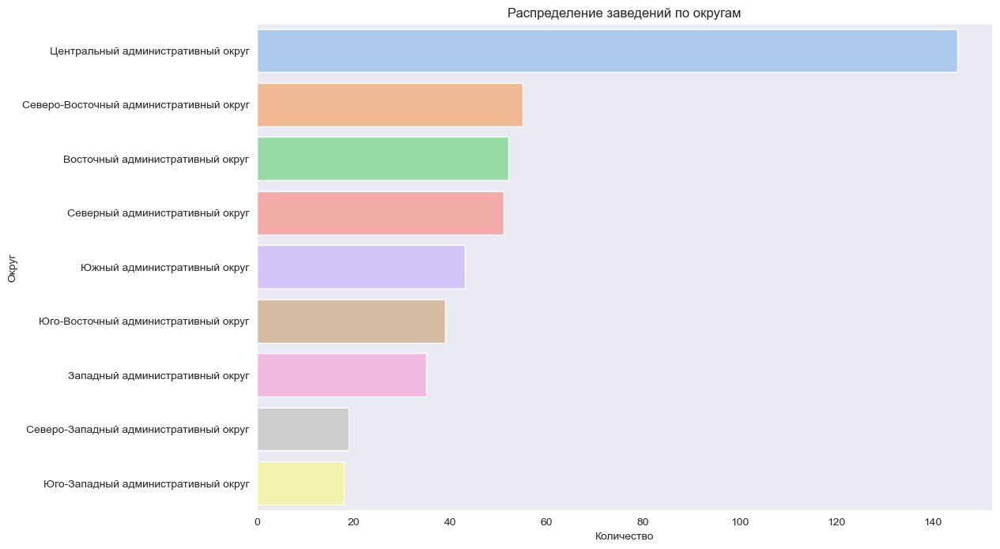

 
Количество заведений по округам: 


,Округ,Количество,"Доля, %"
5,Центральный административный округ,145,31.7
3,Северо-Восточный административный округ,55,12.0
0,Восточный административный округ,52,11.4
2,Северный административный округ,51,11.2
8,Южный административный округ,43,9.4
6,Юго-Восточный административный округ,39,8.5
1,Западный административный округ,35,7.7
4,Северо-Западный административный округ,19,4.2
7,Юго-Западный административный округ,18,3.9


Количество категорий заведений:  9 
Количество заведений:  457 


In [87]:
# Подсчет количества заведений по районам
category_cnt = df_adress_one.groupby('district').agg({'name': 'count'}).reset_index().sort_values(by='name', ascending=False)
category_cnt.columns = ['Округ', 'Количество']
category_cnt['Доля, %'] = round(category_cnt['Количество'] / len(df_adress_one) * 100, 1)

# График распределения событий по категориям
plt.figure(figsize=(12, 8))
plt.title('Распределение заведений по округам')
sns.barplot(x='Количество', y='Округ', data=category_cnt)
plt.show()

# Таблица с количеством заведений по категориям
print(clr_g, '\nКоличество заведений по округам:', clr_b)
display(category_cnt)
print('Количество категорий заведений:', clr_g, len(category_cnt), clr_b)
print('Количество заведений:', clr_g, len(df_adress_one), clr_b)

Наибольшая доля улиц с одним одним заведением в ЦАО (31,7 %), наименьшее в СЗАО и ЮЗАО, 4,1 % и 3,9 % соответственно.

**Общий вывод по исследованию улиц с одним заведением:**

Улицы с одним заведением наиболее распространены в Центральном административном округе (видимо, улицы там короткие). Среди таких объектов преобладают `кафе` (34,9%) и обычно это не сетевые заведения (71%)

<a id='analysis_12'></a>
### Ценовые индикаторы районов города

 
Медиана среднего счета для каждого района: 


,Округ,Медиана среднего счета
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


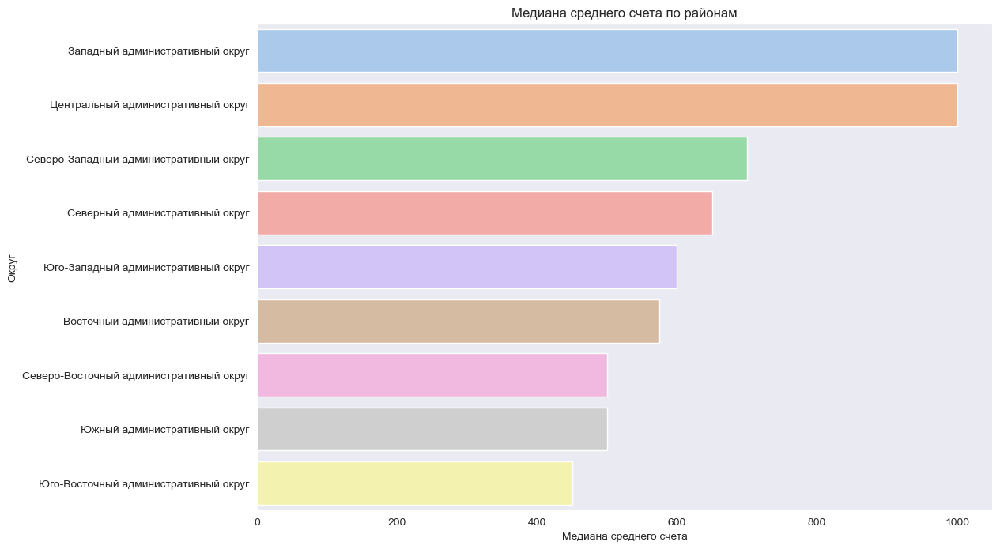

In [88]:
# Отбрасываем нулевые значения средних чеков
df_bills = df_filled.query('middle_avg_bill != 0')

# Расчет медианы среднего чека для каждого района
check_by_district = df_bills.groupby('district', as_index=False)['middle_avg_bill'].median().sort_values(
    by='middle_avg_bill', 
    ascending=False)

check_by_district.columns = ['Округ', 'Медиана среднего счета'] # Названия столбцов таблицы

print(clr_g, '\nМедиана среднего счета для каждого района:', clr_b)
display(check_by_district)

# Диаграмма для медианы среднего счета по районам
plt.figure(figsize=(12, 8))
plt.title('Медиана среднего счета по районам')
sns.barplot(x='Медиана среднего счета', y='Округ', data=check_by_district)
plt.show()

Лидеры по медиане среднего чека: ЦАО и ЗАО (1000). На втором месте СЗАО на втором месте со значением 700. Этот округ выглядит все перспективнее, ранее отмечалось, что в нем мало заведений общепита.

In [89]:
# карта Москвы с ценовыми индикаторами районов

msk_lat, msk_lng = 55.751244, 37.618423 # Задаем широту и долготу центра Москвы

m = Map(location=[msk_lat, msk_lng], zoom_start=10) # Создаем карту Москвы

# Создаем хороплет и добавляем его на карту

Choropleth(
    geo_data = msk_geo,
    data = check_by_district,
    columns = ['Округ', 'Медиана среднего счета'],
    key_on = 'feature.name',
    fill_color = 'YlGn',
    fill_opacity = 0.8,
    legend_name = 'Медиана среднего счета заведений по районам'
    ).add_to(m)

m # Вывод карты

In [90]:
# Карта со средним счетом заведений.

m = Map(location=[msk_lat, msk_lng], zoom_start=10) # Создаем карту Мск
marker_cluster = MarkerCluster().add_to(m) # Добавляем на карту пустой маркер

# Функция для создания кластеров
def creat_clusters(row):
    icon_url = 'https://img.icons8.com/ios/50/null/food-bar.png' # Иконка для ресторана
    icon = CustomIcon(icon_url, icon_size=(30, 30)) # Объект с иконкой 30х30
    
    # Создаем маркер с иконкой и добавляем его на карту
    Marker(
        [row['lat'], row['lng']],
        popup = f"{row['name']} {row['middle_avg_bill']}",
        icon = icon,
        ).add_to(marker_cluster)

# Применяем функцию к таблице с исключенными нулевыми значениями среднего счета
df_bills.apply(creat_clusters, axis=1)

# Вывод карты
m

В целом, с ростом удаленности от центра города можно заметить тенденцию к снижению среднего счета.

**Общий вывод по ценовому анализу:**

- Лидеры по медиане среднего чека: ЦАО и ЗАО (1000). На третьем месте СЗАО со значением 700.
- С ростом удаленности от центра города наблюдается тенденция к снижению среднего счета.

<a id='analysis_13'></a>
### Исследование заведений с плохим рейтингом


Количество заведений с плохим (меньше 3) рейтингом:  210 

Средний чек заведений с плохим рейтингом:  840.19 
 
Распределение заведений с плохим рейтингом по районам:


,Округ,Количество заведений,"Доля, %"
6,Юго-Восточный административный округ,49,23.3
3,Северо-Восточный административный округ,35,16.7
1,Западный административный округ,32,15.2
7,Юго-Западный административный округ,23,11.0
0,Восточный административный округ,21,10.0
2,Северный административный округ,17,8.1
8,Южный административный округ,16,7.6
4,Северо-Западный административный округ,11,5.2
5,Центральный административный округ,6,2.9


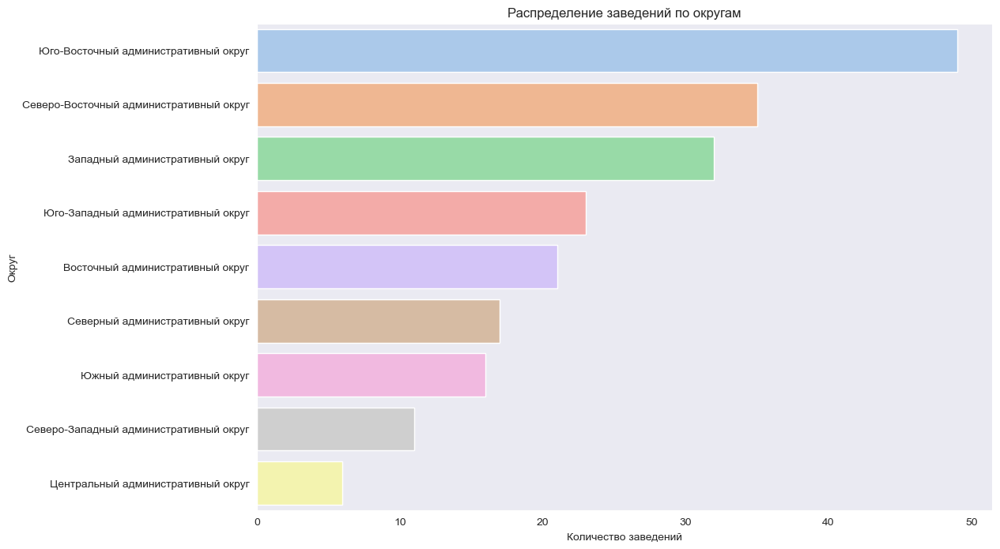

In [91]:
# Таблица заведений с плохим рейтингом
bad_rating = df_filled.query('rating <3')
print('\nКоличество заведений с плохим (меньше 3) рейтингом:', clr_g, len(bad_rating['address']), clr_b)
print('\nСредний чек заведений с плохим рейтингом:',
      clr_g,
      round(bad_rating.loc[(bad_rating['middle_avg_bill'] != 0), 'middle_avg_bill'].mean(), 2),
      clr_b
     )

# Находим распределение по районам
bad_rating_district = bad_rating.groupby('district', as_index=False)['address'].count().sort_values(
    by='address', ascending=False)

bad_rating_district.columns = ['Округ', 'Количество заведений'] # Переименовываем столбцы

bad_rating_district['Доля, %'] = round(bad_rating_district['Количество заведений'] / len(bad_rating['address']) * 100, 1)

print(clr_g, '\nРаспределение заведений с плохим рейтингом по районам:')
display(bad_rating_district)

# График распределения событий по категориям
plt.figure(figsize=(12, 8))
plt.title('Распределение заведений по округам')
sns.barplot(x='Количество заведений', y='Округ', data=bad_rating_district)
plt.show()


Лидер по заведениям с плохим рейтингом - Юго-восточный округ, в ЦАО плохие заведения "не выживают".


Количество заведений с плохим (меньше 3) рейтингом:  210 
 
Распределение заведений с плохим рейтингом по категориям:


,Категория,Количество заведений,"Доля, %"
3,кафе,107,51.0
6,ресторан,32,15.2
2,быстрое питание,31,14.8
4,кофейня,16,7.6
0,"бар,паб",8,3.8
5,пиццерия,8,3.8
7,столовая,6,2.9
1,булочная,2,1.0


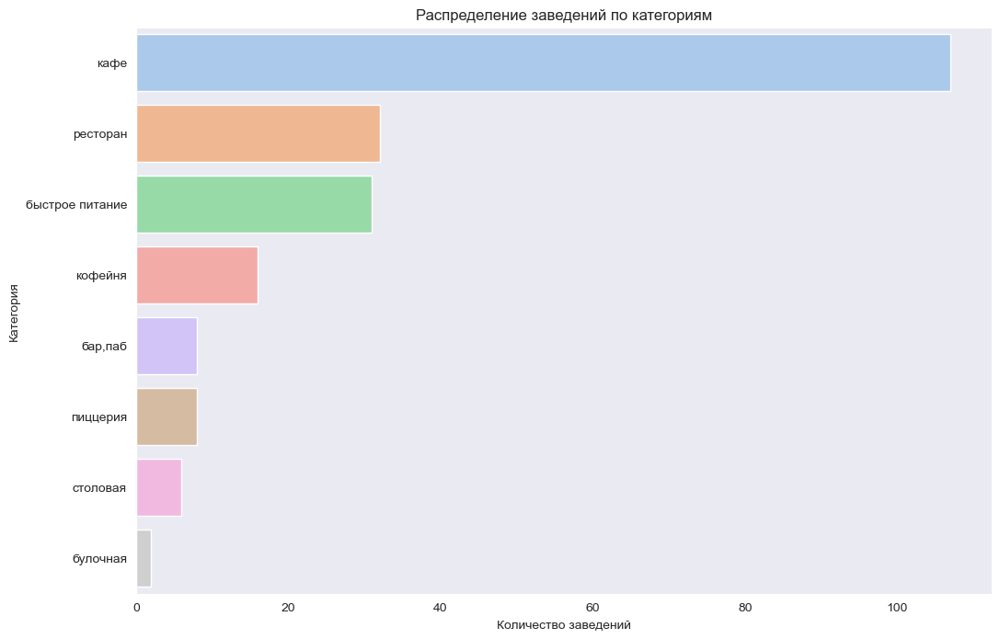

In [92]:
# Распределение заведений с плохим рейтингом по категориям
print('\nКоличество заведений с плохим (меньше 3) рейтингом:', clr_g, len(bad_rating['address']), clr_b)

# Находим распределение по категориям
bad_rating_category = bad_rating.groupby('category', as_index=False)['address'].count().sort_values(
    by='address', ascending=False)

bad_rating_category.columns = ['Категория', 'Количество заведений'] # Переименовываем столбцы

bad_rating_category['Доля, %'] = round(bad_rating_category['Количество заведений'] / len(bad_rating['address']) * 100, 1)

print(clr_g, '\nРаспределение заведений с плохим рейтингом по категориям:')
display(bad_rating_category)

# График распределения событий по категориям
plt.figure(figsize=(12, 8))
plt.title('Распределение заведений по категориям')
sns.barplot(x='Количество заведений', y='Категория', data=bad_rating_category)
plt.show();


Более половины заведений с плохим рейтингом - `кафе`, `рестораны` и `быстрое` питание по 15,2 и 14,8 % соответственно.

 
Медиана среднего счета для каждого района: 


,Округ,Медиана среднего счета
4,Северо-Западный административный округ,1100.0
1,Западный административный округ,1000.0
2,Северный административный округ,900.0
3,Северо-Восточный административный округ,700.0
5,Центральный административный округ,600.0
8,Южный административный округ,470.0
7,Юго-Западный административный округ,325.0
0,Восточный административный округ,290.0
6,Юго-Восточный административный округ,237.5


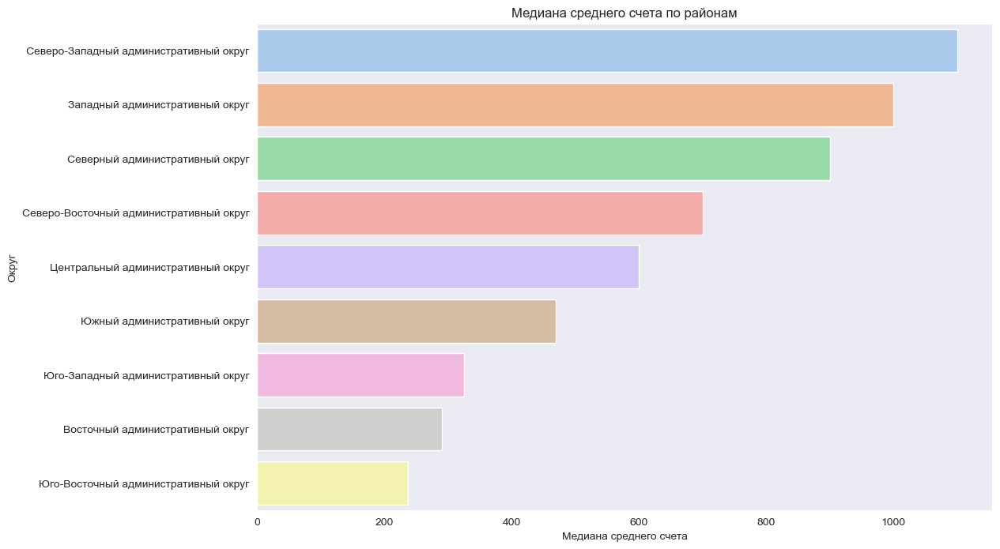

In [93]:
# Расчет медианы среднего чека заведений с плохим рейтингом для каждого района
check_by_district = bad_rating.loc[(bad_rating['middle_avg_bill'] != 0)].groupby(
    'district', as_index=False)['middle_avg_bill'].median().sort_values(by='middle_avg_bill', ascending=False)

check_by_district.columns = ['Округ', 'Медиана среднего счета'] # Названия столбцов таблицы

print(clr_g, '\nМедиана среднего счета для каждого района:', clr_b)
display(check_by_district)

# Диаграмма для медианы среднего счета по районам
plt.figure(figsize=(12, 8))
plt.title('Медиана среднего счета по районам')
sns.barplot(x='Медиана среднего счета', y='Округ', data=check_by_district)
plt.show()

В СЗАО средний чек у заведений с плохим рейтингом выше, чем у остальных. Видимо, рейтинг плохой из-за высокого чека. В ЗАО САО и СВАО различий между хорошими и плохими заведениями не выявлено. В остальных округах средний чек заведений с плохим рейтингом ниже, чем у заведений с хорошим рейтингом.

**Общий вывод по исследованию заведений с плохим рейтингом:**
- ТОП 3 округов с плохими заведенийми: ЮВАО, СВАО, ЗАО. Меньше всего в ЦАО
- Более половины заведений с плохим рейтингом относятся к категории `кафе`
- Обычно средний счет заведений с плохим рейтингом по окугам ниже, чем у заведений с хорошим рейтингом. Исключение - СЗАО. Возможно, в некоторых случай плохой рейтинг связан именно с высоким чеком.

<a id='analysis_conclusion'></a>
### Выводы по исследовательскому анализу данных

- Лидирующие категории по количеству заведений: `кафе` (28%), `ресторан` (24%), `кофейня` (17%).
- большое количество заведений всех категорий находится в ЦАО, недостаточно охвачен заведениями общепита СЗАО 
- Обычное число посадочных мест 75-87.
- 38% заведений общественного питания сетевые. Среди сетевых заведений распространены категории `кофейня`, `ресторан` и `кафе` с примерно одинаковыми долями в 23%.
- Из ТОП 15 по популярности заведений болшинство имеют в городе 1 или 2 точки. По категоряим среди популярных заведений преобладают кафе. 
- Лидер по среднему рейтингу заведений - категория бар,паб. Пиццерии, рестораны и кофейни практически не отличаются по среднему рейтингу заведений. Самый невысокий средний рейтинг в категории быстрое питание.
- Среди ТОП15 улиц с наибольшим количеством заведений - протяженные городские магистрали, исключение - Пятницкая улица в центре.
- Улицы с одним заведением наиболее распространены в ЦАО (улицы короткие). Среди таких объектов преобладают кафе (34,9%) и обычно это не сетевые заведения (71%)
- Лидеры среднемуо чеку: ЦАО и ЗАО (1000). На третьем месте СЗАО со значением 700. С ростом удаленности от центра города наблюдается тенденция к снижению среднего счета.
- Среди заведений с плохим рейтингом преобладают `кафе`. Меньше всего таких заведений в ЦАО, много в ЮВАО, СВАО, ЗАО. Обычно в целом по районам города средний чек в таких заведениях ниже. Исключение - заведения в СЗАО, где он выше.
- Нужно обратить внимание на **Северо-Западный округ города Москвы как на потенциальную локацию для открытия заведения общественного питания** в силу следующих причин: один из лидеров по среднему чеку (700), мало заведений общепита (409, последнее место), меньше конкурентов, парадокс с высоким средним чеком (1100) заведений с плохим рейтингом.

<a id='cofe'></a>
## Исследование по открытию кофейни

<a id='cofe_1'></a>
### Сколько кофеен в датасете и как они распределены


Всего в датасете кофеен:  1413 
 
Распределение кофеен по районам: 


,Округ,Количество кофеен,"Доля, %"
5,Центральный административный округ,428,30.3
2,Северный административный округ,193,13.7
3,Северо-Восточный административный округ,159,11.3
1,Западный административный округ,150,10.6
8,Южный административный округ,131,9.3
0,Восточный административный округ,105,7.4
7,Юго-Западный административный округ,96,6.8
6,Юго-Восточный административный округ,89,6.3
4,Северо-Западный административный округ,62,4.4


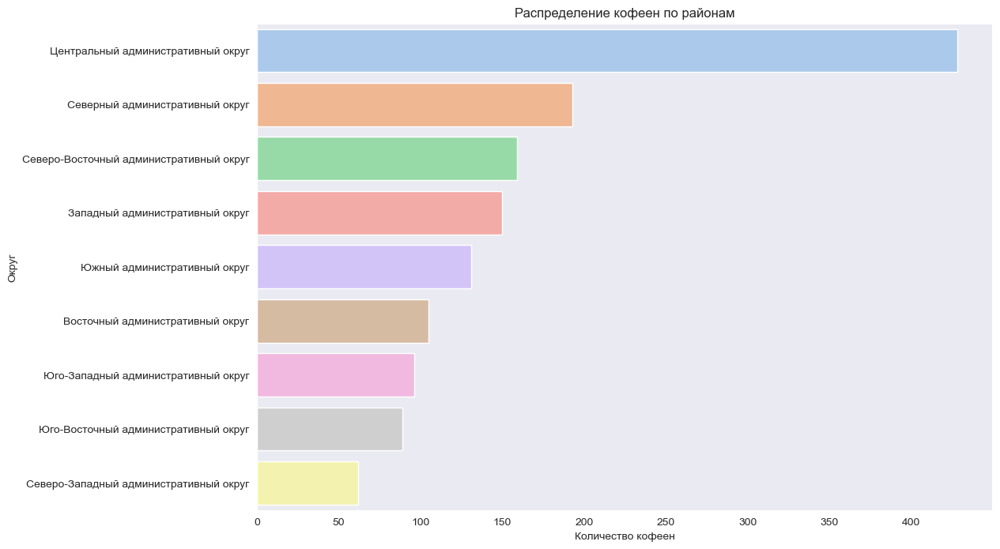

In [94]:
# Таблица с кофйенями
df_cofe = df_filled.query('category == "кофейня"')
print('\nВсего в датасете кофеен:', clr_g, len(df_cofe['address']), clr_b)

# Распределение по районам

# Расчет медианы среднего чека заведений с плохим рейтингом для каждого района
cofe_by_district = df_cofe.groupby(
    'district', as_index=False)['address'].count().sort_values(by='address', ascending=False)

cofe_by_district.columns = ['Округ', 'Количество кофеен'] # Названия столбцов таблицы

cofe_by_district['Доля, %'] = round(cofe_by_district['Количество кофеен'] / len(df_cofe['address']) * 100, 1)

print(clr_g, '\nРаспределение кофеен по районам:', clr_b)
display(cofe_by_district)

# Диаграмма для медианы среднего счета по районам
plt.figure(figsize=(12, 8))
plt.title('Распределение кофеен по районам')
sns.barplot(x='Количество кофеен', y='Округ', data=cofe_by_district)
plt.show()

Всего в Москве 1413 кофеен, 30 % из них находятся в ЦАО. СЗАО - опять самый не охваченный, в нем располагается 4,4 % всех кофеен.

<a id='cofe_2'></a>
### Режим работы кофеен, есть ли круглосуточные

In [95]:
is_24_7_cofe = df_cofe.loc[df_cofe['is_24/7'] == True, 'address'].count()
print('\nКоличество круглосуточных кофеен:', clr_g, is_24_7_cofe, clr_b)
print('Доля круглосуточных кофеен:', 
      clr_g, 
      round(is_24_7_cofe / len(df_cofe['address']) * 100, 1), '%', clr_b)


Количество круглосуточных кофеен:  59 
Доля круглосуточных кофеен:  4.2 % 


Круглосуточных кофеен всего 4,2%.

<a id='cofe_3'></a>
### Рейтинги кофеен и их распределение по районам

In [96]:
print('\nМедианный рейтинг кофеен:', clr_g, df_cofe['rating'].median(), clr_b) # Медианный рейтинг всех кофеен

# Таблица с медианным рейтингом по округам
print(clr_g, '\nМедианный рейтинг кофеен по окугам:', clr_b)
cofe_rating_by_district = df_cofe.groupby('district', as_index=False)['rating'].median().sort_values(
    by='rating', ascending=False)
cofe_rating_by_district.columns = ['Округ', 'Рейтинг кофеен']
display(cofe_rating_by_district)


Медианный рейтинг кофеен:  4.3 
 
Медианный рейтинг кофеен по окугам: 


,Округ,Рейтинг кофеен
0,Восточный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.3
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.3
6,Юго-Восточный административный округ,4.3
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3
1,Западный административный округ,4.2


Медианный рейтинг кофеен по округам не различается.

In [97]:
# Кофейниb на карте Москвы.

# Карта со средним счетом заведений.

m = Map(location=[msk_lat, msk_lng], zoom_start=10) # Создаем карту Мск
marker_cluster = MarkerCluster().add_to(m) # Добавляем на карту пустой маркер

# Функция для создания кластеров
def creat_clusters(row):
    icon_url = 'https://img.icons8.com/ios/50/null/food-bar.png' # Иконка для ресторана
    icon = CustomIcon(icon_url, icon_size=(30, 30)) # Объект с иконкой 30х30
    
    # Создаем маркер с иконкой и добавляем его на карту
    Marker(
        [row['lat'], row['lng']],
        popup = f"{row['name']} {row['rating']}",
        icon = icon,
        ).add_to(marker_cluster)

# Применяем функцию к таблице с исключенными нулевыми значениями среднего счета
df_cofe.apply(creat_clusters, axis=1)

# Вывод карты
m

**Общий вывод по рейтингам кофеен и их распределению по районам:**

Рейтинги кофеен не различаются по округам г. Москвы.

<a id='cofe_4'></a>
### Ориентировочная стоимость чашки капучино при открытии

 Числовое описание данных для столца middle_coffee_cup: 


count     521.000000
mean      175.055662
std        89.753009
min        60.000000
25%       124.000000
50%       170.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

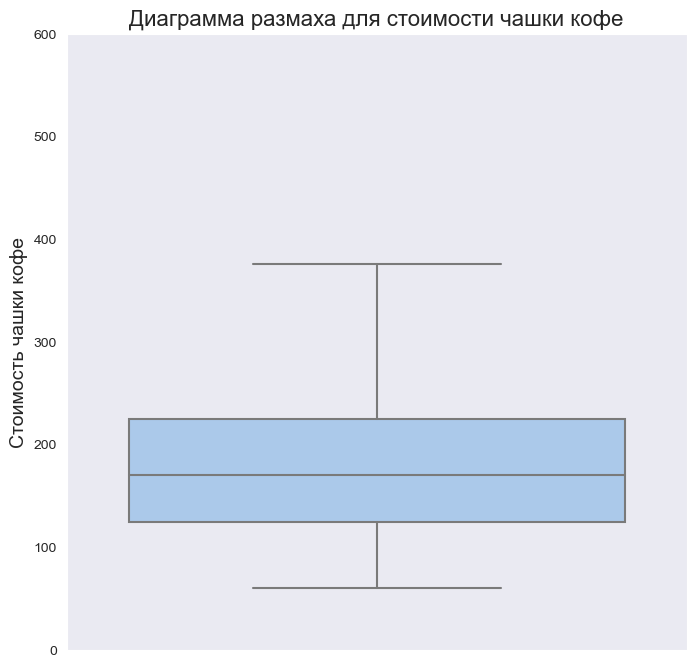

In [98]:
cofe_price = df_cofe.query('middle_coffee_cup != 0') # отбрасываем нулевые значения в middle_coffee_cup
print(clr_g, 'Числовое описание данных для столца middle_coffee_cup:', clr_b)
display(cofe_price['middle_coffee_cup'].describe())

# Диаграмма размаха для middle_coffee_cup
plt.figure(figsize=(8, 8))
plt.title('Диаграмма размаха для стоимости чашки кофе', fontsize = 16)
ax = sns.boxplot(y='middle_coffee_cup', data=cofe_price)
ax.set_ylim([0, 600])
plt.ylabel('Стоимость чашки кофе', fontsize = 14)
plt.show()

Ценообразование - сложный вопрос, зависящий от того, как будет себя позиционировать заведение, на какой сегмент клиентов оно будет ориентироваться. Можно рекомендовать назначать на открытие цену из диапазона между первым и третим квартилем: **от 124 до 225 за чашку капуччино**. Если заведение предполагает работать с массовым дешевым сегментом, то лучше по возможности назначать цену ближе к нижней границе. Если заведение ориентируется на удовлетворение требований потребителей в более дорогом сегменте (особые сорта кофе, атмосфера заведения, ...) - тогда лучше назначать цену ближе к верхней границе.

<a id='recomendations'></a>
### Рекомендации по открытию нового заведения

На основе изложенного выше можно сделать рекомендацию об открытии кофейни в Северо-Западном админстративном округе Москвы. Этот район города является одним из лидеров по среднему чеку (700) и испытывает нехватку заведений общественного питания (409, последнее место). Присутствуют интересные локации для открытия точки общественного питания, такие как жилые районы с большим количеством населения (Митино) или зоны отдыха Серебряный бор и Строгино.

<a id='final'></a>
## Общий вывод

Изучена информация о **8 406** заведениях общественного питания г. Москвы.
Явные дубликаты в данных отсутствовали. Обработаны не явные дубликаты в столбцах `name`, `address`:
- заглавные буквы преобразованы с строчные
- названия города, типа улиц (улица, бульвар и пр.) приведены к единому виду
- разница в написании названий заведений русский / английский проверена и по необходимости исправлена для часто встречающихся сетевых заведений

В ряде столбцов присутствовали пропуски и аномалии. Они были обработаны следующим образом:
- пропуски в столбце `hours`, (рабочие часы) заполнены значением `нет данных`, чтобы не потерять ценную информацию.
- пропуски в столбце `middle_avg_bill` и `seats` заполнены нулевыми значениями, заполнение средними значениями по категориям заведений внесло бы слишком значительные искажения.
-  в столбце `seats` присутствовали аномально большие значения. Они были заполнены средними значениями по категриям заведений.
- пропуски в столбце `avg_bill` заполнены значениями из `middle_avg_bill`. Для случая, когда в `middle_avg_bill` указан ноль, введена новая категория `нет данных`.
- пропуски в столбце `iddle_coffee_cup` заполнены нулями т.к. их было очень много.
- пропуски в столбце price заполнены соответствующими категориям исходя из значений `middle_avg_bill`.
При дальнейших расчетов нулевые значения исключались.

Добавлены два дополнительных столбца: 
- с информацией об улице заведения `street` 
- о режиме работы `24\7 is_24/7`.

В ходе исследовательнского анализа выяснено следующее:
- Лидирующие категории по количеству заведений: `кафе` (28%), `ресторан` (24%), `кофейня` (17%).
- большое количество заведений всех категорий находится в Центральном административном округе (`ЦАО`), недостаточно охвачен заведениями общепита Северо-Западный админстративный округ (`СЗАО`)
- Обычное число посадочных мест в заведениях общественног питания: 75-87.
- 38% заведений общественного питания сетевые. Чаще оказываются сетевыми заведения из категорий `булочная` (61%), `пиццерия` (52 %) и `кофейня` (51 %).
- Из ТОП 15 по популярности заведений болшинство имеют в городе 1 или 2 точки. По категоряим среди популярных заведений преобладают кафе.
- Лидер по среднему рейтингу заведений - категория `бар,паб`. `Пиццерии`, `рестораны` и `кофейни` практически не отличаются по среднему рейтингу заведений. Самый невысокий средний рейтинг в категории быстрое питание.
- Среди ТОП15 улиц с наибольшим количеством заведений - протяженные городские магистрали, исключение - Пятницкая улица в центре.
- Улицы с одним заведением наиболее распространены в `ЦАО` (улицы короткие). Среди таких объектов преобладают кафе (34,9%) и обычно это не сетевые заведения (71%)
- Лидеры среднемуо чеку: `ЦАО` и Западный административный округ (`ЗАО`) (1000). На третьем месте `СЗАО` со значением 700. С ростом удаленности от центра города наблюдается тенденция к снижению среднего счета.
- Среди заведений с плохим рейтингом преобладают кафе. Меньше всего таких заведений в `ЦАО`, много в Юго-Восточном административном округе (`ЮВАО`), Северо-Восточном административном округе (`СВАО`), `ЗАО`. В целом по районам города средний чек в таких заведениях ниже. Исключение - заведения в `СЗАО`, где средний чек выше.

На основе изложенного выше можно сделать рекомендацию об открытии **кофейни в Северо-Западном админстративном округе Москвы**. Этот район города является одним из лидеров по среднему чеку, испытывает нехватку заведений общественного питания в нем есть интересные локации для открытия точки общественного питания, такие как жилые районы с большим количеством населения (Митино) или зоны отдыха Серебряный бор и Строгино. Стоимость за чашку капуччино от **124 до 225** рублей.